In [1]:
import re, pickle, os, torch, csv
import numpy as np
import pandas as pd
from pathlib import Path
from tqdm import tqdm
from bertopic import BERTopic
import datetime
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

import statsmodels.api as sm
from sklearn.preprocessing import normalize
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import minmax_scale
from scipy.cluster.hierarchy import fcluster, linkage
from sklearn.metrics.pairwise import cosine_similarity
from scipy.interpolate import interp1d
from sklearn.utils.extmath import safe_sparse_dot

from cuml.preprocessing import Normalizer


/mnt/home/ande2472/miniconda3/envs/hdbscan5/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
## Variables

dir_0 = Path('/mnt/scratch/ande2472/sjrouts/0to264_topjournals')
dir_12 = Path('/mnt/scratch/ande2472/sjrouts/1200to1526_topjournals')
dir_24 = Path('/mnt/scratch/ande2472/sjrouts/2400to2771_topjournals')
dir_36 = Path('/mnt/scratch/ande2472/sjrouts/3600to3938_topjournals')
dir_48 = Path('/mnt/scratch/ande2472/sjrouts/4800to5418_topjournals')
dir_64 = Path('/mnt/scratch/ande2472/sjrouts/6400to7093_topjournals')

dirf_0 = Path('/mnt/scratch/ande2472/sjrouts/0to264_full')
dirf_12 = Path('/mnt/scratch/ande2472/sjrouts/1200to1526_full')
dirf_24 = Path('/mnt/scratch/ande2472/sjrouts/2400to2771_full')
dirf_36 = Path('/mnt/scratch/ande2472/sjrouts/3600to3938_full')
dirf_48 = Path('/mnt/scratch/ande2472/sjrouts/4800to5418_full')

csv_dir_0 = Path('/mnt/scratch/ande2472/data/0_topjournals')
csv_dir_12 = Path('/mnt/scratch/ande2472/data/1200_topjournals')
csv_dir_24 = Path('/mnt/scratch/ande2472/data/2400_topjournals')
csv_dir_36 = Path('/mnt/scratch/ande2472/data/3600_topjournals')
csv_dir_48 = Path('/mnt/scratch/ande2472/data/4800_topjournals')
csv_dir_64 = Path('/mnt/scratch/ande2472/data/6400_topjournals')

dir_0full = Path('/mnt/scratch/ande2472/sjrouts/0to264_full/')
dir_12full = Path('/mnt/scratch/ande2472/sjrouts/1200to1526_full/')
dir_24full = Path('/mnt/scratch/ande2472/sjrouts/2400to2771_full/')
dir_36full = Path('/mnt/scratch/ande2472/sjrouts/3600to3938_full/')
dir_48full = Path('/mnt/scratch/ande2472/sjrouts/4800to5418_full/')

lowess_dir_0 = Path(dir_0full/'lowess')
lowess_dir_0.mkdir(parents=True, exist_ok=True)
topic_info_0 = pd.read_csv(dir_0full/'topic_info.csv').drop(columns='Unnamed: 0')
topic_info_12 = pd.read_csv(dir_12full/'topic_info.csv').drop(columns='Unnamed: 0')
topic_info_24 = pd.read_csv(dir_24full/'topic_info.csv').drop(columns='Unnamed: 0')
topic_info_36 = pd.read_csv(dir_36full/'topic_info.csv').drop(columns='Unnamed: 0')
topic_info_48 = pd.read_csv(dir_48full/'topic_info.csv').drop(columns='Unnamed: 0')
# topic_info_64 = pd.read_csv(dir_64/'topic_info.csv').drop(columns='Unnamed: 0')

# topic_freq_0 = pd.read_csv(dir_0/'topic_freq.csv').drop(columns='Unnamed: 0')
# topic_freq_12 = pd.read_csv(dir_12/'topic_freq.csv').drop(columns='Unnamed: 0')
# topic_freq_24 = pd.read_csv(dir_24/'topic_freq.csv').drop(columns='Unnamed: 0')
# topic_freq_36 = pd.read_csv(dir_36/'topic_freq.csv').drop(columns='Unnamed: 0')
# topic_freq_48 = pd.read_csv(dir_48/'topic_freq.csv').drop(columns='Unnamed: 0')
# topic_freq_64 = pd.read_csv(dir_64/'topic_freq.csv').drop(columns='Unnamed: 0')



In [3]:
def general_vis(topic_info, save_file=None, title = None, labels=None):
   # topic_info = pd.read_csv(topic_info_dir/'topic_info.csv').drop(columns='Unnamed: 0')
    if labels is not None:
        topic_info['Label'] = labels
    topic_info_sorted = topic_info.sort_values(by=['Count'])
    if labels is not None:
        topic_names = list(topic_info_sorted.Label.values)
    else:
        topic_names  = list(topic_info_sorted.Name.values)
    topic_counts = list(topic_info_sorted.Count.values)
    y_pos        = len(topic_names)

    plt.figure(figsize=(8,14))
    plt.barh(topic_names[:50], topic_counts[:50])
#ax.set_yticks(y_pos, labels=topic_names)

    plt.xlabel('Number of records', weight = 'bold',style='italic', fontsize = 16)
    plt.ylabel('Topic Labels', weight = 'bold', style='italic',fontsize = 16)
    if title is not None:
        plt.title(title, weight = 'bold',style='italic', fontsize = 18)
    plt.tight_layout()
    if save_file is not None:
        plt.savefig(save_file,bbox_inches='tight')

def general_vis_log(topic_info, save_file=None, title = None):
    #topic_info = pd.read_csv(topic_info_dir/'topic_info.csv').drop(columns='Unnamed: 0')
    topic_info_sorted = topic_info.sort_values(by=['Count'])
    topic_names  = list(topic_info_sorted.Name.values)
    topic_counts = list(topic_info_sorted.Count.values)
    y_pos        = len(topic_names)

    plt.figure(figsize=(8,12))
    plt.barh(topic_names, np.log10(topic_counts))
#ax.set_yticks(y_pos, labels=topic_names)
    plt.xlabel('Number of records')
    if title is not None:
        plt.title(title)
    plt.tight_layout()
    if save_file is not None:
        plt.savefig(save_file)

In [4]:
def expand_docs(documents, data, topic_model, save_dir=None):
    docs = documents
    docs['Year'] = pd.to_datetime(data['Date']).dt.year
    docs['Journal'] = data['Journal']
    docs = docs.drop(columns='ID')

    docs['Date'] = pd.to_datetime(data['Date'])
# documents['Timestamp'] = documents['Date'].dt.timestamp()
    ts_for_bins = list(docs['Date'])
    ts_for_bins.sort()

    bin_num  = 20
    bin_size = int(len(ts_for_bins)/bin_num)
    bin_idxs = [idx for idx in range(0, len(ts_for_bins), bin_size)]

    bin_timestamps = [ts_for_bins[idx] for idx in bin_idxs]

    max_timestamp      = max(ts_for_bins) + pd.Timedelta(1, unit='D')

    bin_df         = pd.DataFrame(list(zip(bin_idxs, bin_timestamps)),
            columns=['bin_start_idx', 'bin_start_date'])

    bin_df['Count'] = bin_df['bin_start_idx'].diff().fillna(bin_df['bin_start_idx'].iloc[0]).astype(int)
    bin_df['bin_end_date'] = bin_df['bin_start_date'].shift(-1) - pd.Timedelta(days=1)
    bin_df['bin_end_date'][20] = max(docs['Date']) + pd.Timedelta(1, unit='D')

    bin_period = []
    docs['bin_period'] = 0

    for i in tqdm(range(len(docs))):
        period = 0
        while docs['Date'][i] > bin_df['bin_end_date'][period] and period < len(bin_df):
            period +=1
        
            # doc = documents['Date'][i]
            # bindate = bin_df['bin_end_date'][period]

            # print(f'Period: {period}.. {doc} < {bindate}')

    # print(f'Assigning Document: {i} bin: {period}')
        docs['bin_period'][i] = period

    if save_dir is not None:
        with open(save_dir/'new_docs.pickle', "wb") as f:
            pickle.dump(docs, f)
        print(f"Docs saved at: {save_dir}")
    
    return docs


In [5]:
def year_graph(documents, stopyear=1960, save_file=None, title = None):
    docs = documents
    if stopyear is not None:
        for i in range(len(docs['Year'])):
            if documents['Year'][i] < stopyear:
                documents['Year'][i] = stopyear - 1
    yeardf = documents.groupby('Year').count()
    yeardf['Count'] = yeardf['Journal']
    yeardf = yeardf.drop(columns = ['Journal', 'Topic', 'Document'])
    yeardf = yeardf.reset_index()
    plt.figure(figsize=(6,6))
    plt.barh(yeardf['Year'], yeardf['Count'])
    plt.ylabel('Year')
    plt.xlabel('Numbers of documents')
    plt.yticks(range(1960, 2021, 5))
    if title is not None:
        plt.title(title)
    if save_file is not None:
        plt.savefig(save_file)


def year_graph_log(documents, stopyear=None, save_file=None, title = None):
    docs = documents
    if stopyear is not None:
        for i in range(len(docs['Year'])):
            if documents['Year'][i] < stopyear:
                documents['Year'][i] = stopyear - 1
    yeardf = documents.groupby('Year').count()
    yeardf['Count'] = yeardf['Journal']
    yeardf = yeardf.drop(columns = ['Journal', 'Topic', 'Document'])
    yeardf = yeardf.reset_index()
    plt.figure(figsize=(6,6))
    plt.barh(yeardf['Year'], np.log10(yeardf['Count']))
    plt.ylabel('Year')
    plt.xlabel('log10(Numbers of documents)')
    if title is not None:
        plt.title(title)
    plt.yticks(range(1960, 2021, 5))
    if save_file is not None:
        plt.savefig(save_file)


In [6]:
def topics_over_time_freq(documents, topic_labels, save_img=None, title=None, index=None, plot= True):
    topic_frequency_norm = documents.groupby('Topic')['bin_period'].value_counts(normalize=True).unstack(fill_value=0)
    if len(topic_frequency_norm.columns) == 21:
        df_norm = topic_frequency_norm.drop(20, axis=1)
    else:
        df_norm = topic_frequency_norm
    df_norm = df_norm.reset_index()
    if index is not None:
        df_norm = np.take(df_norm, index, axis=0)
    if plot == True:
        fig = px.imshow(df_norm.iloc[:,1:21], width=1400, height=1200, aspect="auto", color_continuous_scale='deep', zmin=0,zmax=.2)
        fig.update_layout(
        yaxis=dict(
                tickvals=list(range(len(df_norm))),
            ticktext=topic_labels,
            tickfont=dict(size=13)
        ),
        margin=dict(l=600)
        )
        if title is not None:
            fig.update_layout(
            title=dict(text=title, y=0.97, x=0.5, xanchor='center')
                )
        fig.show()
        if save_img is not None:
            fig.write_image(save_img)

        return df_norm

In [7]:
def topics_over_time(documents, topic_labels, save_img=None, title=None, index=None):
    topic_frequency_norm = documents.groupby('Topic')['bin_period'].value_counts(normalize=True).unstack(fill_value=0)
    if len(topic_frequency_norm.columns) == 21:
        df = topic_frequency_norm.drop(20, axis=1)
    else:
        df = topic_frequency_norm
    df_norm = df.sub(df.min(axis=1), axis=0).div((df.max(axis=1) - df.min(axis=1)), axis=0)
    df_norm = df_norm.reset_index()
    if index is not None:
        df_norm = np.take(df_norm, index, axis=0)
    df_norm['largest'] = df_norm.iloc[:,1:21].values.argmax(axis=1)
   
    df_norm = df_norm.sort_values('largest')
    df_norm = df_norm.reset_index()
    sorted_index = [topic_labels[i] for i in df_norm['index']]
    fig = px.imshow(df_norm.iloc[:,2:22], width=1400, height=2200, aspect="auto", color_continuous_scale='deep')
    fig.update_layout(
       yaxis=dict(
            tickvals=list(range(len(df_norm['index']))),
           ticktext=sorted_index,
           tickfont=dict(size=13),
           title = dict(font_size=18,text="<i><b>Topic Labels</b></i>")),
           xaxis=dict(title = dict(font_size=18,text="<i><b>Bin Period</b></i>")),
    margin=dict(l=600)
    )
    if title is not None:
        fig.update_layout(
        title=dict(text=title, y=0.97, x=0.5, xanchor='center')
            )
    fig.show()
    if save_img is not None:
        fig.write_image(save_img)

    return df_norm


In [8]:
def get_lowess(toc, x, y, frac, it=3, dir_lowess="dir_lowess", plot=0):

  lowess = sm.nonparametric.lowess
  lowess_fit = lowess(y, x, frac=frac, it=it) 
  lowess_x   = list(zip(*lowess_fit))[0]
  lowess_y   = list(zip(*lowess_fit))[1]

  # create a function using the interp1d method
  lowesss_f  = interp1d(lowess_x, lowess_y, bounds_error=False)

  # save the function
  f_file = dir_lowess / f"lowess_fit_func_topic{toc}_frac{frac}.pickle"
  with open(f_file, "wb") as f:
    pickle.dump(lowesss_f, f)

  #x_line = [i/10. for i in range(400)]
  # define a sequence of inputs between the smallest and largest known inputs
  x_line = np.arange(min(x), max(x), (max(x)-min(x))/100)
  y_line = lowesss_f(x_line)

  # For xtick labels
  #x_date = [datetime.fromtimestamp(ts+1).strftime('%Y-%m-%d') for ts in lowess_x]

  # Create series
  lowess_ser = pd.Series(lowess_y, index=lowess_x, name=toc)

  if plot:
    # get 2 decimal points for mse
    mse = "{:.2f}".format(mean_squared_error(y, lowess_y))
    plt.figure()
    plt.title(f"topic {toc}, MSE={mse}")
    plt.plot(x, y, 'o')
    #plt.plot(lowess_x, lowess_y, '*')
    plt.plot(lowess_x, lowess_y, '*')
    #plt.plot(x_new, y_new, '-')
    plt.plot(x_line, y_line, '-')

    #https://stackabuse.com/rotate-axis-labels-in-matplotlib/
   # plt.xticks(ticks=lowess_x, labels=x_date, rotation=90, fontsize=4)
    plt.xlabel("Date")
    plt.ylabel("Frequency")
    plt.ylim([0, max([max(y), max(lowess_y)])])
    plt.tight_layout()
 
    plt.savefig(dir_lowess / \
                          f'figure_topic_{toc}_lowess_frac{frac}.pdf')

    plt.close()
    
  return lowess_ser 

def get_lowess_mult(toc_list,y, x_num=20, frac=.2,   it=3, dir_lowess="dir_lowess", plot=True):

  x = np.array(range(0,x_num))
  plt.figure()
  df = pd.DataFrame(0, index=np.arange(len(toc_list)),columns=list(x)) 
  for i in range(len(toc_list)):
    lowess = sm.nonparametric.lowess
    lowess_fit = lowess(y.iloc[i].drop('Topic'), x, frac=frac, it=it) 
    lowess_x   = list(zip(*lowess_fit))[0]
    lowess_y   = list(zip(*lowess_fit))[1]

    # create a function using the interp1d method
    lowesss_f  = interp1d(lowess_x, lowess_y, bounds_error=False)

    # save the function
    # f_file = dir_lowess / f"lowess_fit_func_topic{toc}_frac{frac}.pickle"
    # with open(f_file, "wb") as f:
    #   pickle.dump(lowesss_f, f)

    #x_line = [i/10. for i in range(400)]
    # define a sequence of inputs between the smallest and largest known inputs
    x_line = np.arange(min(x), max(x), (max(x)-min(x))/100)
    y_line = lowesss_f(x_line)

    # For xtick labels
    #x_date = [datetime.fromtimestamp(ts+1).strftime('%Y-%m-%d') for ts in lowess_x]

    # Create series
    lowess_ser = pd.Series(lowess_y, index=lowess_x) #name=toc)

    if plot:
      # get 2 decimal points for mse
     # mse = "{:.2f}".format(mean_squared_error(y, lowess_y))
      
     # plt.title(f"topic {toc}, MSE={mse}")
      plt.plot(x, y.drop(columns=['Topic']).T, 'o')
      #plt.plot(lowess_x, lowess_y, '*')
      plt.plot(lowess_x, lowess_y, '*')
      #plt.plot(x_new, y_new, '-')
      plt.plot(x_line, y_line, '-')

      #https://stackabuse.com/rotate-axis-labels-in-matplotlib/
    # plt.xticks(ticks=lowess_x, labels=x_date, rotation=90, fontsize=4)
      plt.xlabel("Date")
      plt.ylabel("Frequency")
      plt.ylim([0, max([max(y), max(lowess_y)])])
      plt.tight_layout()
  
    # plt.savefig(dir_lowess / \
    #                       f'figure_topic_{toc}_lowess_frac{frac}.pdf')

    plt.close()
      
  return lowess_ser 

In [9]:
def fit_topics(matrix, frac, it, dir_lowess):
  '''Lowess fit each topic and save the outputs
  Args:
    frac (float): The fraction of the data used when estimating each y-value.
    it (int): The number of residual-based reweightings to perform.
  Output:
    
  '''

  # Create a subfolder for the specific frac
  # Decide not to use this, so I can compare each fit side by side
  #dir_lowess_frac = dir_lowess / f"_{frac}"
  #dir_lowess_frac.mkdir(parents=True, exist_ok=True)

  max_y_idxs      = [] # indices (x, timestamps) with max y
  lowess_ser_list = [] # list of lowess-fitted series for different topics
  for i in tqdm(range(len(matrix))):
    topic_ID = matrix['Topic'][i]
    x = np.array(matrix.drop('Topic',axis=1).columns)
    y = np.array(matrix.drop('Topic',axis=1).iloc[i])

    # series after lowess smoothing
    lowess_ser = get_lowess(topic_ID, x, y, frac, it, dir_lowess, plot=1)

    max_y_idx  = lowess_ser.idxmax()
    max_y_idxs.append(max_y_idx)
    lowess_ser_list.append(lowess_ser)

  # for topic order
  max_y_idxs_ser = pd.Series(max_y_idxs, index=matrix['Topic'], name='max_y_timestamp')
  max_y_idxs_ser.to_csv(dir_lowess / \
         f"table_1_arabidopsis_timestamps_with_max_y_lowess_frac{frac}.txt")
  
  # Create a dataframe with lowess fits
  #https://sparkbyexamples.com/pandas/pandas-create-dataframe-from-multiple-series/
  lowess_df = pd.concat(lowess_ser_list, axis=1).transpose()

  # Sort the dataframe based on timestamps
  #https://www.geeksforgeeks.org/how-to-sort-a-pandas-dataframe-based-on-column-names-or-row-index/
  lowess_df.sort_index(inplace=True, axis=1)

  # Save the dataframe to file
  lowess_df.to_csv(dir_lowess / \
         f"table_1_arabidopsis_toc_timestamps_lowess_vals_{frac}.txt")

  return max_y_idxs_ser, lowess_df

In [83]:
x

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19])

In [ ]:
def topic_comparison_chart():
    

In [81]:
matrix_12[matrix_12['Topic']==48]

bin_period,index,Topic,0,1,2,3,4,5,6,7,...,11,12,13,14,15,16,17,18,19,largest
0,49,48,1.0,0.830664,0.486651,0.349352,0.179252,0.130435,0.17849,0.113654,...,0.032037,0.039664,0.032037,0.015256,0.016781,0.007628,0.004577,0.0,0.003051,0


In [21]:
for i in range(5):
    topic_ID = matrix['Topic'][i]
    x = np.array(matrix.drop('Topic',axis=1).columns)
    y = np.array(matrix.drop('Topic',axis=1).iloc[i])

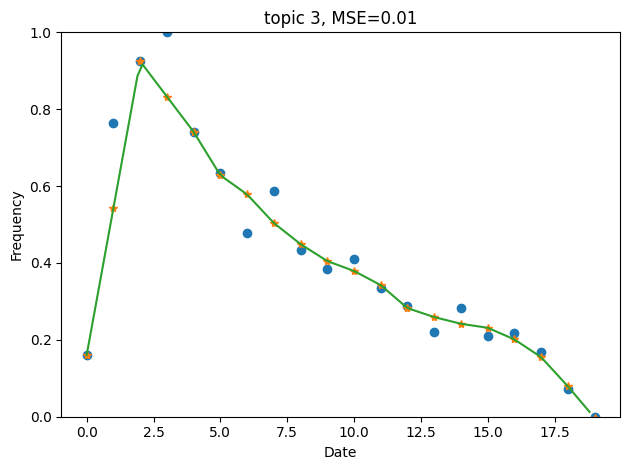

In [22]:

lowess_ser = get_lowess(topic_ID, x, y, .2, 3, plot=1)

In [23]:
lowess_ser.idxmax()

2.0

In [28]:
lowess_dir_0

In [14]:
max_y_idxs_ser, lowess_df = fit_topics(matrix2, .3,3, lowess_dir_0)

100%|██████████| 100/100 [00:23<00:00,  4.18it/s]


Int64Index([55, 62, 45, 74, 36, 39, 13, 46, 32, 10, 29,  8, 83, 58, 85, 96, 86,
            65, 16, 24, 26, 89,  3, 54, 20, 68, 33, 35, 71, 79, 38, -1, 78, 11,
            81,  6, 42, 72, 18, 44, 76,  0, 61, 63, 80, 73, 48, 41, 17, 21, 43,
            94, 64, 19, 90, 60, 47, 75, 15, 52, 93, 59, 31, 30, 28, 82, 27, 14,
            25, 92, 97, 53,  1,  5, 49, 91, 88, 67, 34, 37, 40, 50, 70, 66, 56,
            51, 95,  2, 22,  4, 84,  7,  9, 12, 77, 23, 69, 57, 87, 98],
           dtype='int64', name='Topic')

In [21]:
matrix

bin_period,Topic,0,1,2,3,4,5,6,7,8,...,10,11,12,13,14,15,16,17,18,19
0,-1,0.000000,0.490190,0.606718,0.822533,0.940547,1.000000,0.882580,0.854637,0.693817,...,0.638823,0.524078,0.388823,0.246136,0.193222,0.239001,0.147741,0.300832,0.258621,0.262782
1,0,0.000000,0.229826,0.287282,0.705617,0.666882,0.782440,0.616527,0.769529,1.000000,...,0.669464,0.595868,0.530019,0.638476,0.571336,0.495158,0.387347,0.288573,0.251130,0.380891
2,1,0.000000,0.005997,0.012994,0.045977,0.047976,0.133433,0.819090,0.936532,0.771614,...,0.867566,0.791604,0.886557,0.977011,0.976012,1.000000,0.889555,0.800600,0.692654,0.690155
3,2,0.236842,0.419549,0.130827,0.000000,0.066917,0.178195,0.181203,0.324060,0.290977,...,0.387970,0.468421,0.574436,0.569173,0.603759,0.771429,0.896992,0.887970,0.882707,1.000000
4,3,0.160398,0.764381,0.924779,1.000000,0.741150,0.633850,0.477876,0.587389,0.433628,...,0.409292,0.334071,0.288717,0.220133,0.282080,0.209071,0.216814,0.169248,0.071903,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,94,0.000000,0.000000,0.000000,0.666667,0.250000,0.500000,0.666667,1.000000,0.833333,...,0.333333,0.750000,0.583333,0.500000,0.500000,0.250000,0.083333,0.333333,0.083333,0.250000
96,95,0.000000,0.000000,0.000000,0.011494,0.000000,0.000000,0.000000,0.000000,0.011494,...,0.011494,0.000000,0.000000,0.000000,0.000000,0.011494,0.000000,0.000000,0.252874,1.000000
97,96,1.000000,0.739130,0.260870,0.217391,0.130435,0.434783,0.130435,0.260870,0.130435,...,0.173913,0.173913,0.304348,0.086957,0.173913,0.086957,0.086957,0.043478,0.130435,0.000000
98,97,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.357143,0.571429,0.500000,...,0.214286,0.214286,1.000000,0.857143,0.928571,0.500000,0.500000,0.357143,0.214286,0.714286


[55,
 62,
 45,
 74,
 36,
 39,
 13,
 46,
 32,
 10,
 29,
 8,
 83,
 58,
 85,
 96,
 86,
 65,
 16,
 24,
 26,
 89,
 3,
 54,
 20,
 68,
 33,
 35,
 71,
 79,
 38,
 -1,
 78,
 11,
 81,
 6,
 42,
 72,
 18,
 44,
 76,
 0,
 61,
 63,
 80,
 73,
 48,
 41,
 17,
 21,
 43,
 94,
 64,
 19,
 90,
 60,
 47,
 75,
 15,
 52,
 93,
 59,
 31,
 30,
 28,
 82,
 27,
 14,
 25,
 92,
 97,
 53,
 1,
 5,
 49,
 91,
 88,
 67,
 34,
 37,
 40,
 50,
 70,
 66,
 56,
 51,
 95,
 2,
 22,
 4,
 84,
 7,
 9,
 12,
 77,
 23,
 69,
 57,
 87,
 98]

In [39]:
kobe = np.take(matrix, list(max_y_idxs_ser.sort_values().index), axis=0)

In [41]:
kobe.iloc[:,1:21]

bin_period,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
60,0.035714,0.000000,0.160714,0.160714,0.410714,0.660714,0.714286,0.696429,1.000000,0.767857,0.732143,0.928571,0.732143,0.767857,0.750000,0.535714,0.660714,0.714286,0.375000,0.375000
31,0.281250,0.406250,0.356250,0.356250,0.050000,0.162500,0.087500,0.650000,0.512500,0.643750,0.631250,0.943750,1.000000,0.556250,0.406250,0.193750,0.125000,0.056250,0.012500,0.000000
73,0.000000,0.089286,0.339286,1.000000,0.857143,0.607143,0.250000,0.250000,0.232143,0.232143,0.267857,0.232143,0.178571,0.250000,0.160714,0.160714,0.285714,0.214286,0.196429,0.267857
49,1.000000,0.125749,0.000000,0.317365,0.083832,0.335329,0.239521,0.341317,0.269461,0.245509,0.131737,0.047904,0.137725,0.053892,0.167665,0.191617,0.221557,0.209581,0.137725,0.233533
42,0.000000,0.009950,0.000000,0.129353,0.626866,1.000000,0.835821,0.875622,0.766169,0.676617,0.616915,0.447761,0.393035,0.293532,0.383085,0.228856,0.238806,0.189055,0.149254,0.084577
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54,0.000000,0.000000,0.000000,0.011905,0.011905,0.059524,0.166667,0.178571,0.297619,0.369048,0.964286,0.857143,0.976190,1.000000,0.916667,0.916667,0.833333,0.678571,0.773810,0.773810
92,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.333333,0.333333,0.500000,1.000000,0.555556,0.944444,0.555556,0.611111,0.888889,0.444444,0.666667,0.500000
75,0.917808,1.000000,0.794521,0.273973,0.301370,0.178082,0.150685,0.150685,0.095890,0.068493,0.013699,0.041096,0.000000,0.027397,0.041096,0.013699,0.013699,0.013699,0.013699,0.013699
2,0.000000,0.005997,0.012994,0.045977,0.047976,0.133433,0.819090,0.936532,0.771614,0.886057,0.867566,0.791604,0.886557,0.977011,0.976012,1.000000,0.889555,0.800600,0.692654,0.690155


In [35]:
lowess_df

,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,15.0,16.0,17.0,18.0,19.0
-1,0.047585,0.048985,0.050386,0.051435,0.051960,0.052148,0.052012,0.051656,0.051327,0.050963,0.050557,0.050007,0.049370,0.048867,0.048535,0.048420,0.048506,0.048577,0.048667,0.048747
0,0.028332,0.035526,0.042813,0.049216,0.054691,0.057362,0.058117,0.058009,0.057836,0.057254,0.055372,0.053559,0.052717,0.051921,0.050751,0.047998,0.044348,0.041844,0.041324,0.041021
1,0.002604,0.003590,0.004606,0.005722,0.006900,0.006770,0.034467,0.053508,0.063747,0.067504,0.068948,0.070516,0.072426,0.075356,0.076814,0.075001,0.070677,0.064837,0.059383,0.054040
2,0.030037,0.024696,0.019477,0.016698,0.018098,0.021895,0.027926,0.032162,0.036117,0.039827,0.044815,0.050920,0.056228,0.061736,0.068471,0.076164,0.083188,0.088288,0.092241,0.096062
3,0.073091,0.074707,0.074835,0.073118,0.070432,0.064371,0.060226,0.055833,0.052772,0.049936,0.047311,0.044886,0.042267,0.040373,0.038912,0.037956,0.035894,0.032633,0.028386,0.023903
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,0.006220,0.009225,0.013849,0.024485,0.038180,0.055935,0.072948,0.082241,0.087622,0.086546,0.081671,0.075958,0.069831,0.060060,0.048427,0.038694,0.031637,0.027434,0.028678,0.029566
95,-0.000569,0.000473,0.001461,0.001477,0.001461,0.000551,0.000693,0.001852,0.002846,0.003798,0.002846,0.001851,0.000679,0.000809,0.003112,0.007604,0.017699,0.000000,0.194690,0.769912
96,0.206495,0.153433,0.101882,0.056412,0.034903,0.034192,0.035650,0.037632,0.039737,0.038511,0.039912,0.040803,0.037597,0.035074,0.027675,0.022083,0.018361,0.015722,0.011504,0.007663
97,0.000000,0.000000,0.000000,0.000000,0.005134,0.020203,0.039442,0.059590,0.067535,0.058165,0.052872,0.064945,0.082664,0.104746,0.099988,0.082278,0.062434,0.055528,0.064401,0.073336


In [11]:
topic_model = BERTopic.load(dir_0/'model_outliers_reduced')

Tue Apr  9 09:44:33 2024 Building and compiling search function


In [72]:
topic_info_0['Name'][0]

'-1_patients_cells_cell_protein'

## 0 to 264 Journal Analysis

### General Vis

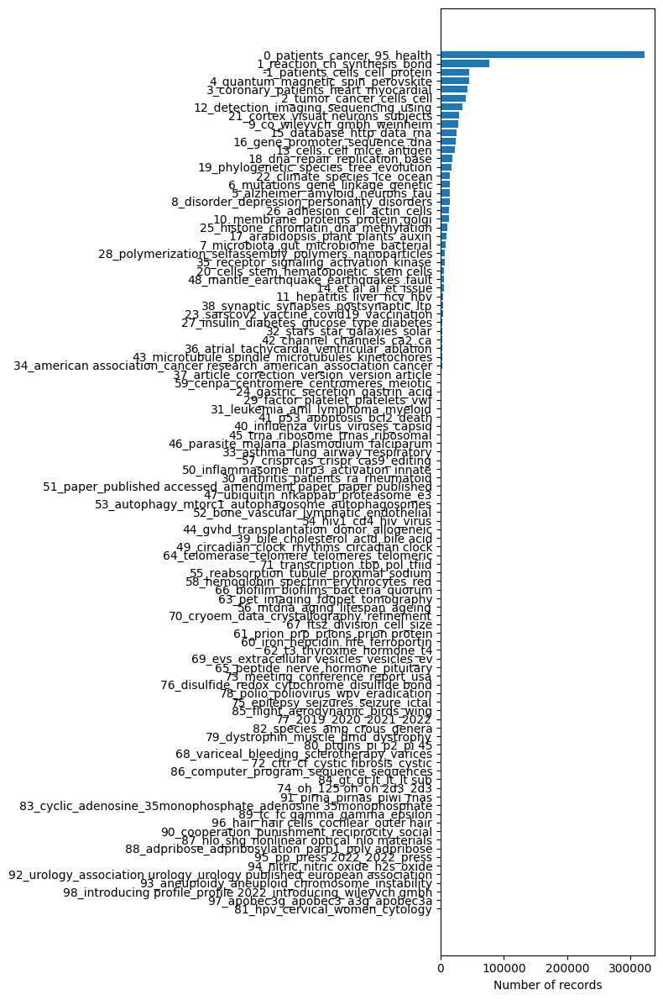

In [3]:
topic_info = topic_info_0
topic_info_sorted = topic_info.sort_values(by=['Count'])
topic_names  = list(topic_info_sorted.Name.values)
topic_counts = list(topic_info_sorted.Count.values)
y_pos        = len(topic_names)

plt.figure(figsize=(8,12))
plt.barh(topic_names, topic_counts)
#ax.set_yticks(y_pos, labels=topic_names)
plt.xlabel('Number of records')

plt.tight_layout()

  #plt.savefig(outputfile4)

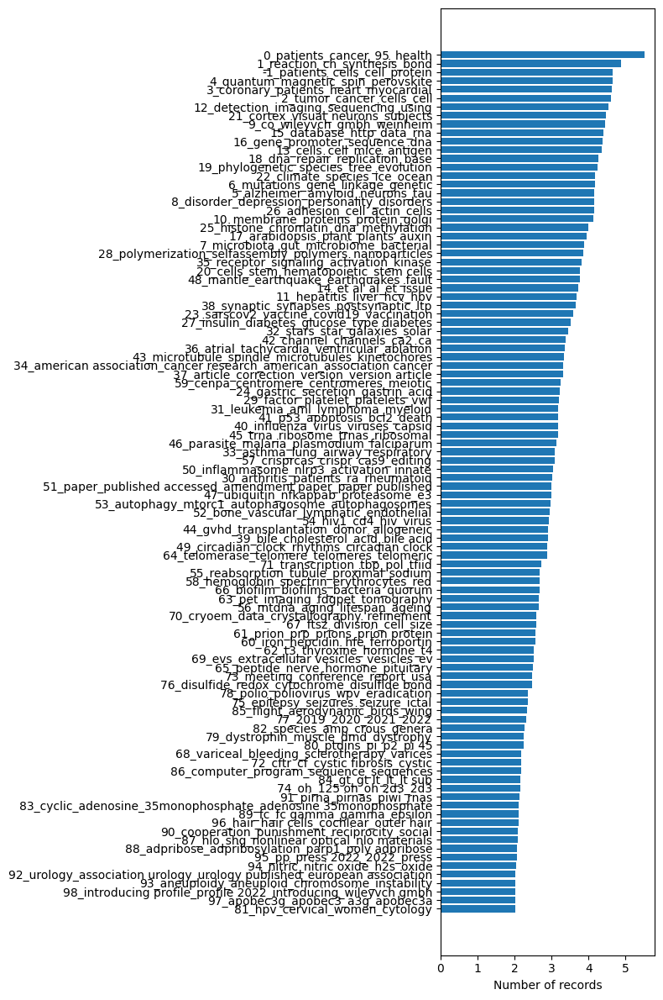

In [13]:
topic_info = topic_info_0
topic_info_sorted = topic_info.sort_values(by=['Count'])
topic_names  = list(topic_info_sorted.Name.values)
topic_counts = list(topic_info_sorted.Count.values)
y_pos        = len(topic_names)

plt.figure(figsize=(8,12))
plt.barh(topic_names, np.log10(topic_counts))
#ax.set_yticks(y_pos, labels=topic_names)
plt.xlabel('Number of records')
plt.tight_layout()
  #plt.savefig(outputfile4)

### Over Time

#### Data Cleaning

In [10]:
with open(dir_0/'documents.pickle', "rb") as f:
  documents = pickle.load(f)


In [6]:
data = pd.read_csv(csv_dir_0/'0to264_topjournals.csv', sep='\t')

In [7]:
data

,Unnamed: 0,index,PMID,Date,Journal,Title,Abstract,txt
0,137,272,273,1975-11-01,Gut,Involvement of the small intestine in systemic...,A patient is reported with mast cell infiltrat...,Involvement of the small intestine in systemic...
1,138,273,274,1975-09-01,Gut,Gastric pH and microflora of normal and diarrh...,The microflora and pH of gastric contents were...,Gastric pH and microflora of normal and diarrh...
2,227,405,406,1975-11-01,The Journal of cell biology,"Structure, composition, physical properties, a...",Peroxisome proliferation has been induced with...,"Structure, composition, physical properties, a..."
3,228,406,407,1975-12-01,The Journal of cell biology,Localization of NADH oxidase on the surface of...,The ultrastructural localization of NADH oxida...,Localization of NADH oxidase on the surface of...
4,229,407,408,1975-12-01,The Journal of cell biology,Defective lysosomal enzyme secretion in kidney...,The beige mouse is an animal model for the hum...,Defective lysosomal enzyme secretion in kidney...
...,...,...,...,...,...,...,...,...
974819,23496836,10671,36475543,2022-12-08,eLife,A method for low-coverage single-gamete sequen...,Recently published single-cell sequencing data...,A method for low-coverage single-gamete sequen...
974820,23496837,10672,36475542,2022-12-08,eLife,Destabilizers of the thymidylate synthase homo...,Drugs that target human thymidylate synthase (...,Destabilizers of the thymidylate synthase homo...
974821,23496838,10673,36475544,2022-12-08,eLife,eDNA-stimulated cell dispersion from Caulobact...,"In their natural environment, most bacteria pr...",eDNA-stimulated cell dispersion from Caulobact...
974822,23496839,10674,36475545,2022-12-08,eLife,Weakly migratory metastatic breast cancer cell...,"Cancer cell migration is highly heterogeneous,...",Weakly migratory metastatic breast cancer cell...


In [8]:
topic_model = BERTopic.load(dir_0/'model_outliers_reduced')

Fri Mar 29 12:56:49 2024 Building and compiling search function


In [7]:
documents['Year'] = pd.to_datetime(data['Date']).dt.year
documents['Journal'] = data['Journal']
documents = documents.drop(columns='ID')

In [8]:
for i in range(len(documents['Year'])):
    if documents['Year'][i] < 1960:
        documents['Year'][i] = 1959


In [11]:
yeardf = documents.groupby('Year').count()
yeardf['Count'] = yeardf['Journal']
yeardf = yeardf.drop(columns = ['Journal', 'Topic', 'Document'])
yeardf = yeardf.reset_index()

#### Year Graphs

([<matplotlib.axis.YTick at 0x2ad2ac444a30>,
 [Text(0, 1960, '1960'),
  Text(0, 1965, '1965'),
  Text(0, 1970, '1970'),
  Text(0, 1975, '1975'),
  Text(0, 1980, '1980'),
  Text(0, 1985, '1985'),
  Text(0, 1990, '1990'),
  Text(0, 1995, '1995'),
  Text(0, 2000, '2000'),
  Text(0, 2005, '2005'),
  Text(0, 2010, '2010'),
  Text(0, 2015, '2015'),
  Text(0, 2020, '2020')])

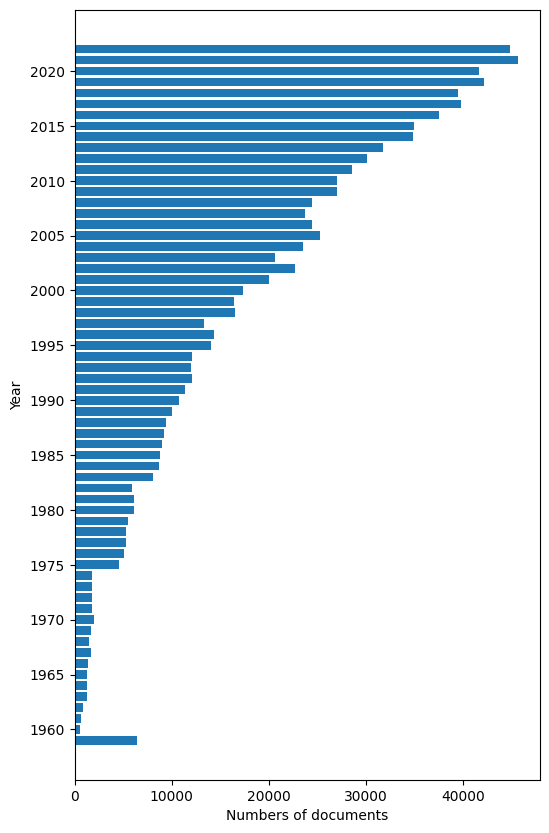

In [11]:
plt.figure(figsize=(6,10))
plt.barh(yeardf['Year'], yeardf['Count'])
plt.ylabel('Year')
plt.xlabel('Numbers of documents')
plt.yticks(range(1960, 2021, 5))

([<matplotlib.axis.YTick at 0x2ad2944f3d90>,
 [Text(0, 1960, '1960'),
  Text(0, 1965, '1965'),
  Text(0, 1970, '1970'),
  Text(0, 1975, '1975'),
  Text(0, 1980, '1980'),
  Text(0, 1985, '1985'),
  Text(0, 1990, '1990'),
  Text(0, 1995, '1995'),
  Text(0, 2000, '2000'),
  Text(0, 2005, '2005'),
  Text(0, 2010, '2010'),
  Text(0, 2015, '2015'),
  Text(0, 2020, '2020')])

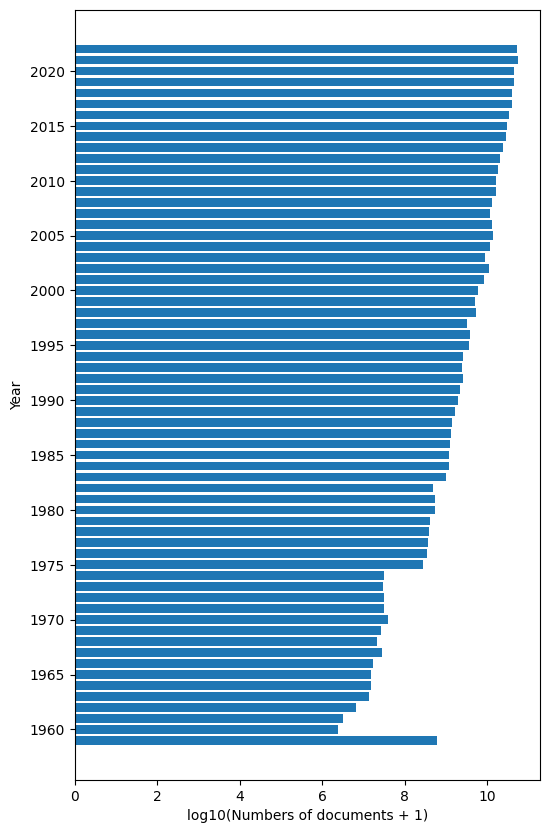

In [20]:
plt.figure(figsize=(6,10))
plt.barh(yeardf['Year'], np.log(yeardf['Count']))
plt.ylabel('Year')

# +1 so the x-axis value is not zero.
plt.xlabel('log10(Numbers of documents + 1)')
plt.yticks(range(1960, 2021, 5))

#### Binning Values

In [9]:
documents['Date'] = pd.to_datetime(data['Date'])
# documents['Timestamp'] = documents['Date'].dt.timestamp()
ts_for_bins = list(documents['Date'])
ts_for_bins.sort()

In [10]:
bin_num  = 20
bin_size = int(len(ts_for_bins)/bin_num)
bin_idxs = [idx for idx in range(0, len(ts_for_bins), bin_size)]

In [11]:
bin_timestamps = [ts_for_bins[idx] for idx in bin_idxs]

In [12]:
max_timestamp      = max(ts_for_bins) + pd.Timedelta(1, unit='D')

In [13]:
bin_df         = pd.DataFrame(list(zip(bin_idxs, bin_timestamps)),
            columns=['bin_start_idx', 'bin_start_date'])

In [14]:

bin_df['Count'] = bin_df['bin_start_idx'].diff().fillna(bin_df['bin_start_idx'].iloc[0]).astype(int)
bin_df['bin_end_date'] = bin_df['bin_start_date'].shift(-1) - pd.Timedelta(days=1)
bin_df['bin_end_date'][20] = max(documents['Date']) + pd.Timedelta(1, unit='D')

In [17]:
bin_df

,bin_start_idx,bin_start_date,Count,bin_end_date
0,0,1881-04-16,0,1979-01-31
1,48741,1979-02-01,48741,1985-12-31
2,97482,1986-01-01,48741,1990-12-31
3,146223,1991-01-01,48741,1995-01-31
4,194964,1995-02-01,48741,1998-07-20
5,243705,1998-07-21,48741,2001-05-15
6,292446,2001-05-16,48741,2003-08-01
7,341187,2003-08-02,48741,2005-09-19
8,389928,2005-09-20,48741,2007-09-21
9,438669,2007-09-22,48741,2009-08-25


#### Run Topics over time

In [18]:
with open(dir_0/'new_docs.pickle', "wb") as f:
        pickle.dump(documents, f)

In [ ]:
with open(dir_0/'new_docs.pickle', "rb") as f:
    documents = pickle.load(f)

In [15]:
bin_period = []
documents['bin_period'] = 0

for i in tqdm(range(len(documents))):
    period = 0
    while documents['Date'][i] > bin_df['bin_end_date'][period] and period < len(bin_df):
        period +=1
     
        # doc = documents['Date'][i]
        # bindate = bin_df['bin_end_date'][period]

        # print(f'Period: {period}.. {doc} < {bindate}')

   # print(f'Assigning Document: {i} bin: {period}')
    documents['bin_period'][i] = period

        
    

100%|██████████| 974824/974824 [06:22<00:00, 2547.33it/s]


In [15]:
topic_frequency = documents.groupby('bin_period')['Topic'].value_counts().unstack(fill_value=0)
topic_frequency_norm = documents.groupby('Topic')['bin_period'].value_counts(normalize=True).unstack(fill_value=0)

In [16]:
topic_frequency_norm

bin_period,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
Topic,,,,,,,,,,,,,,,,,,,,,
-1,0.047292,0.049886,0.050503,0.051645,0.052270,0.052584,0.051963,0.051815,0.050964,0.051211,...,0.050066,0.049350,0.048595,0.048315,0.048557,0.048074,0.048884,0.048661,0.048683,0.000011
0,0.027772,0.037436,0.039852,0.057444,0.055815,0.060674,0.053697,0.060131,0.069823,0.057444,...,0.052829,0.050060,0.054620,0.051797,0.048594,0.044060,0.039907,0.038332,0.043789,0.000000
1,0.002924,0.003385,0.003924,0.006463,0.006616,0.013194,0.065972,0.075012,0.062317,0.071126,...,0.063856,0.071165,0.078127,0.078050,0.079897,0.071396,0.064548,0.056239,0.056047,0.000038
2,0.029964,0.046363,0.020448,0.008706,0.014712,0.024700,0.024970,0.037792,0.034823,0.038332,...,0.050749,0.060265,0.059792,0.062896,0.077946,0.089216,0.088406,0.087934,0.098461,0.000000
3,0.033731,0.072260,0.082492,0.087291,0.070778,0.063933,0.053983,0.060970,0.051161,0.047985,...,0.044810,0.041917,0.037541,0.041493,0.036836,0.037330,0.034295,0.028086,0.023499,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,0.008333,0.008333,0.008333,0.075000,0.033333,0.058333,0.075000,0.108333,0.091667,0.083333,...,0.083333,0.066667,0.058333,0.058333,0.033333,0.016667,0.041667,0.016667,0.033333,0.000000
95,0.000000,0.000000,0.000000,0.008850,0.000000,0.000000,0.000000,0.000000,0.008850,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.008850,0.000000,0.000000,0.194690,0.769912,0.000000
96,0.209091,0.154545,0.054545,0.045455,0.027273,0.090909,0.027273,0.054545,0.027273,0.045455,...,0.036364,0.063636,0.018182,0.036364,0.018182,0.018182,0.009091,0.027273,0.000000,0.000000


In [20]:
topic_frequency_norm = topic_frequency_norm.reset_index()

bin_period,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0.047292,0.049886,0.050503,0.051645,0.052270,0.052584,0.051963,0.051815,0.050964,0.051211,0.050673,0.050066,0.049350,0.048595,0.048315,0.048557,0.048074,0.048884,0.048661,0.048683
1,0.027772,0.037436,0.039852,0.057444,0.055815,0.060674,0.053697,0.060131,0.069823,0.057444,0.055924,0.052829,0.050060,0.054620,0.051797,0.048594,0.044060,0.039907,0.038332,0.043789
2,0.002924,0.003385,0.003924,0.006463,0.006616,0.013194,0.065972,0.075012,0.062317,0.071126,0.069703,0.063856,0.071165,0.078127,0.078050,0.079897,0.071396,0.064548,0.056239,0.056047
3,0.029964,0.046363,0.020448,0.008706,0.014712,0.024700,0.024970,0.037792,0.034823,0.038332,0.043528,0.050749,0.060265,0.059792,0.062896,0.077946,0.089216,0.088406,0.087934,0.098461
4,0.033731,0.072260,0.082492,0.087291,0.070778,0.063933,0.053983,0.060970,0.051161,0.047985,0.049608,0.044810,0.041917,0.037541,0.041493,0.036836,0.037330,0.034295,0.028086,0.023499
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.008333,0.008333,0.008333,0.075000,0.033333,0.058333,0.075000,0.108333,0.091667,0.083333,0.041667,0.083333,0.066667,0.058333,0.058333,0.033333,0.016667,0.041667,0.016667,0.033333
96,0.000000,0.000000,0.000000,0.008850,0.000000,0.000000,0.000000,0.000000,0.008850,0.000000,0.008850,0.000000,0.000000,0.000000,0.000000,0.008850,0.000000,0.000000,0.194690,0.769912
97,0.209091,0.154545,0.054545,0.045455,0.027273,0.090909,0.027273,0.054545,0.027273,0.045455,0.036364,0.036364,0.063636,0.018182,0.036364,0.018182,0.018182,0.009091,0.027273,0.000000
98,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.046729,0.074766,0.065421,0.093458,0.028037,0.028037,0.130841,0.112150,0.121495,0.065421,0.065421,0.046729,0.028037,0.093458


In [77]:
topic_model

#### Heatmap1

In [33]:
# fig = px.imshow(topic_frequency_norm.iloc[:,1:21], width=1000, height=1200, aspect="auto", color_continuous_scale='deep_r', zmin=0, zmax=.15)
# fig.update_layout(
#     yaxis=dict(
#         tickvals=list(range(len(topic_info_0['Name']))),
#         ticktext=topic_info_0['Name']
# ))
# fig.show()

with open(dir_0/'new_docs.pickle', "rb") as f:
  docs_0 = pickle.load(f)
matrix = topics_over_time(docs_0, topic_info_0)
#index=list(max_y_idxs_ser.sort_values().index)

bin_period  Topic         0         1         2         3         4         5  \
0              -1  0.000000  0.490190  0.606718  0.822533  0.940547  1.000000   
1               0  0.000000  0.229826  0.287282  0.705617  0.666882  0.782440   
2               1  0.000000  0.005997  0.012994  0.045977  0.047976  0.133433   
3               2  0.236842  0.419549  0.130827  0.000000  0.066917  0.178195   
4               3  0.160398  0.764381  0.924779  1.000000  0.741150  0.633850   
..            ...       ...       ...       ...       ...       ...       ...   
95             94  0.000000  0.000000  0.000000  0.666667  0.250000  0.500000   
96             95  0.000000  0.000000  0.000000  0.011494  0.000000  0.000000   
97             96  1.000000  0.739130  0.260870  0.217391  0.130435  0.434783   
98             97  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
99             98  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   

bin_period         6       

In [11]:
matrix2 = topics_over_time_original(docs_0, topic_info_0)
#index=list(max_y_idxs_ser.sort_values().index)

In [28]:
df = matrix.drop(20, axis=1)
df_norm = df.sub(df.min(axis=1), axis=0).div((df.max(axis=1) - df.min(axis=1)), axis=0)

In [29]:
df_norm

bin_period,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
Topic,,,,,,,,,,,,,,,,,,,,
-1,0.000000,0.490190,0.606718,0.822533,0.940547,1.000000,0.882580,0.854637,0.693817,0.740488,0.638823,0.524078,0.388823,0.246136,0.193222,0.239001,0.147741,0.300832,0.258621,0.262782
0,0.000000,0.229826,0.287282,0.705617,0.666882,0.782440,0.616527,0.769529,1.000000,0.705617,0.669464,0.595868,0.530019,0.638476,0.571336,0.495158,0.387347,0.288573,0.251130,0.380891
1,0.000000,0.005997,0.012994,0.045977,0.047976,0.133433,0.819090,0.936532,0.771614,0.886057,0.867566,0.791604,0.886557,0.977011,0.976012,1.000000,0.889555,0.800600,0.692654,0.690155
2,0.236842,0.419549,0.130827,0.000000,0.066917,0.178195,0.181203,0.324060,0.290977,0.330075,0.387970,0.468421,0.574436,0.569173,0.603759,0.771429,0.896992,0.887970,0.882707,1.000000
3,0.160398,0.764381,0.924779,1.000000,0.741150,0.633850,0.477876,0.587389,0.433628,0.383850,0.409292,0.334071,0.288717,0.220133,0.282080,0.209071,0.216814,0.169248,0.071903,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,0.000000,0.000000,0.000000,0.666667,0.250000,0.500000,0.666667,1.000000,0.833333,0.750000,0.333333,0.750000,0.583333,0.500000,0.500000,0.250000,0.083333,0.333333,0.083333,0.250000
95,0.000000,0.000000,0.000000,0.011494,0.000000,0.000000,0.000000,0.000000,0.011494,0.000000,0.011494,0.000000,0.000000,0.000000,0.000000,0.011494,0.000000,0.000000,0.252874,1.000000
96,1.000000,0.739130,0.260870,0.217391,0.130435,0.434783,0.130435,0.260870,0.130435,0.217391,0.173913,0.173913,0.304348,0.086957,0.173913,0.086957,0.086957,0.043478,0.130435,0.000000


In [24]:
df

bin_period,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
Topic,,,,,,,,,,,,,,,,,,,,,
-1,0.047292,0.049886,0.050503,0.051645,0.052270,0.052584,0.051963,0.051815,0.050964,0.051211,...,0.050066,0.049350,0.048595,0.048315,0.048557,0.048074,0.048884,0.048661,0.048683,0.000011
0,0.027772,0.037436,0.039852,0.057444,0.055815,0.060674,0.053697,0.060131,0.069823,0.057444,...,0.052829,0.050060,0.054620,0.051797,0.048594,0.044060,0.039907,0.038332,0.043789,0.000000
1,0.002924,0.003385,0.003924,0.006463,0.006616,0.013194,0.065972,0.075012,0.062317,0.071126,...,0.063856,0.071165,0.078127,0.078050,0.079897,0.071396,0.064548,0.056239,0.056047,0.000038
2,0.029964,0.046363,0.020448,0.008706,0.014712,0.024700,0.024970,0.037792,0.034823,0.038332,...,0.050749,0.060265,0.059792,0.062896,0.077946,0.089216,0.088406,0.087934,0.098461,0.000000
3,0.033731,0.072260,0.082492,0.087291,0.070778,0.063933,0.053983,0.060970,0.051161,0.047985,...,0.044810,0.041917,0.037541,0.041493,0.036836,0.037330,0.034295,0.028086,0.023499,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,0.008333,0.008333,0.008333,0.075000,0.033333,0.058333,0.075000,0.108333,0.091667,0.083333,...,0.083333,0.066667,0.058333,0.058333,0.033333,0.016667,0.041667,0.016667,0.033333,0.000000
95,0.000000,0.000000,0.000000,0.008850,0.000000,0.000000,0.000000,0.000000,0.008850,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.008850,0.000000,0.000000,0.194690,0.769912,0.000000
96,0.209091,0.154545,0.054545,0.045455,0.027273,0.090909,0.027273,0.054545,0.027273,0.045455,...,0.036364,0.063636,0.018182,0.036364,0.018182,0.018182,0.009091,0.027273,0.000000,0.000000


In [23]:
df_norm

bin_period,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
Topic,,,,,,,,,,,,,,,,,,,,,
-1,0.899330,0.948677,0.960408,0.982134,0.994015,1.000000,0.988179,0.985366,0.969176,0.973875,...,0.952089,0.938473,0.924108,0.918781,0.923390,0.914203,0.929615,0.925365,0.925784,0.0
0,0.397745,0.536159,0.570762,0.822706,0.799378,0.868974,0.769051,0.861198,1.000000,0.822706,...,0.756610,0.716952,0.782271,0.741835,0.695956,0.631026,0.571540,0.548989,0.627138,0.0
1,0.036127,0.041908,0.048651,0.080443,0.082370,0.164740,0.825626,0.938825,0.779865,0.890173,...,0.799133,0.890655,0.977842,0.976879,1.000000,0.893545,0.807803,0.703757,0.701349,0.0
2,0.304318,0.470870,0.207676,0.088417,0.149417,0.250857,0.253598,0.383825,0.353667,0.389308,...,0.515422,0.612063,0.607265,0.638794,0.791638,0.906100,0.897875,0.893077,1.000000,0.0
3,0.386419,0.827809,0.945028,1.000000,0.810833,0.732417,0.618432,0.698464,0.586095,0.549717,...,0.513339,0.480194,0.430073,0.475344,0.421989,0.427648,0.392886,0.321746,0.269200,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,0.076923,0.076923,0.076923,0.692308,0.307692,0.538462,0.692308,1.000000,0.846154,0.769231,...,0.769231,0.615385,0.538462,0.538462,0.307692,0.153846,0.384615,0.153846,0.307692,0.0
95,0.000000,0.000000,0.000000,0.011494,0.000000,0.000000,0.000000,0.000000,0.011494,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.011494,0.000000,0.000000,0.252874,1.000000,0.0
96,1.000000,0.739130,0.260870,0.217391,0.130435,0.434783,0.130435,0.260870,0.130435,0.217391,...,0.173913,0.304348,0.086957,0.173913,0.086957,0.086957,0.043478,0.130435,0.000000,0.0


## 1200 to 1526

#### yearstuff

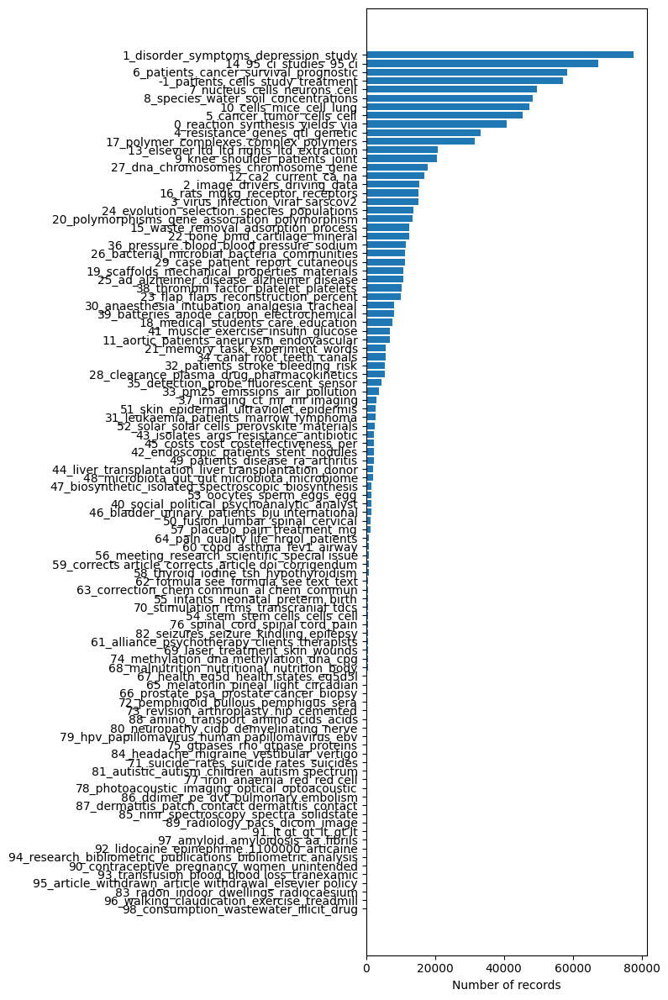

In [108]:
topic_info = topic_info_12
topic_info_sorted = topic_info.sort_values(by=['Count'])
topic_names  = list(topic_info_sorted.Name.values)
topic_counts = list(topic_info_sorted.Count.values)
y_pos        = len(topic_names)

plt.figure(figsize=(8,12))
plt.barh(topic_names, topic_counts)
#ax.set_yticks(y_pos, labels=topic_names)
plt.xlabel('Number of records')

plt.tight_layout()

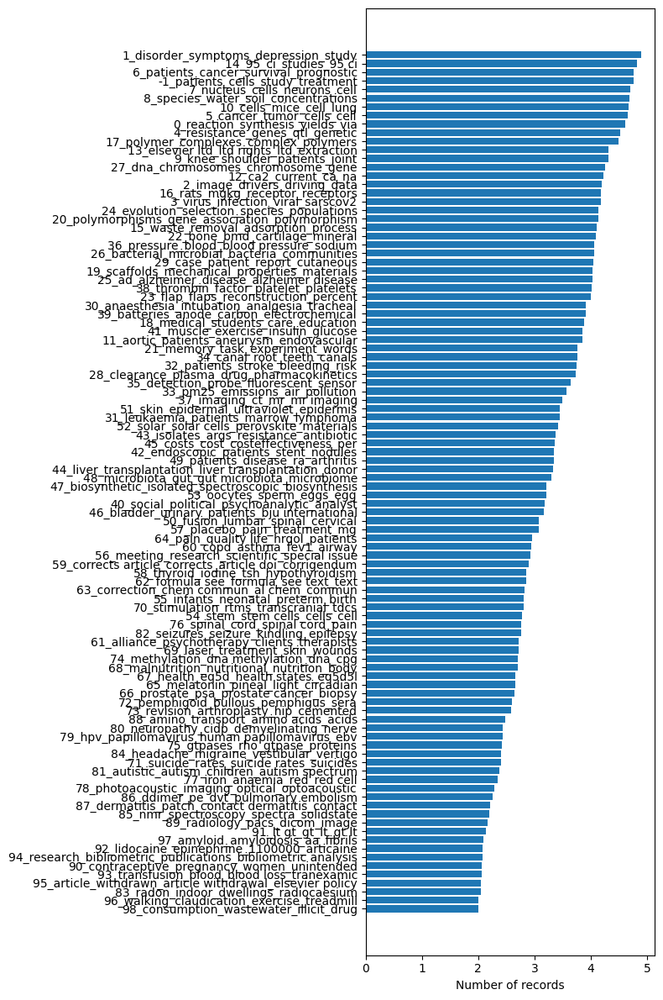

In [109]:
topic_info = topic_info_12
topic_info_sorted = topic_info.sort_values(by=['Count'])
topic_names  = list(topic_info_sorted.Name.values)
topic_counts = list(topic_info_sorted.Count.values)
y_pos        = len(topic_names)

plt.figure(figsize=(8,12))
plt.barh(topic_names, np.log10(topic_counts))
#ax.set_yticks(y_pos, labels=topic_names)
plt.xlabel('Number of records')
plt.tight_layout()
  #plt.savefig(outputfile4)

In [ ]:
with open(dir_12/'documents.pickle', "rb") as f:
  documents = pickle.load(f)

In [139]:
with open(dir_12/'new_docs.pickle', "rb") as f:
    documents = pickle.load(f)

In [111]:
topic_model = BERTopic.load(dir_12/'model_outliers_reduced')

Thu Mar 28 11:19:49 2024 Building and compiling search function


In [140]:
data = pd.read_csv(csv_dir_12/'1200to1526_topjournals.csv', sep='\t')

In [141]:
documents['Journal'] = data['Journal']

In [132]:
documents['Year'] = pd.to_datetime(data['Date']).dt.year
documents['Journal'] = data['Journal']
documents = documents.drop(columns='ID')

In [133]:
for i in range(len(documents['Year'])):
    if documents['Year'][i] < 1960:
        documents['Year'][i] = 1959

In [134]:
yeardf = documents.groupby('Year').count()
yeardf['Count'] = yeardf['Journal']
yeardf = yeardf.drop(columns = ['Journal', 'Topic', 'Document'])
yeardf = yeardf.reset_index()

([<matplotlib.axis.YTick at 0x2b513a6fb3a0>,
 [Text(0, 1960, '1960'),
  Text(0, 1965, '1965'),
  Text(0, 1970, '1970'),
  Text(0, 1975, '1975'),
  Text(0, 1980, '1980'),
  Text(0, 1985, '1985'),
  Text(0, 1990, '1990'),
  Text(0, 1995, '1995'),
  Text(0, 2000, '2000'),
  Text(0, 2005, '2005'),
  Text(0, 2010, '2010'),
  Text(0, 2015, '2015'),
  Text(0, 2020, '2020')])

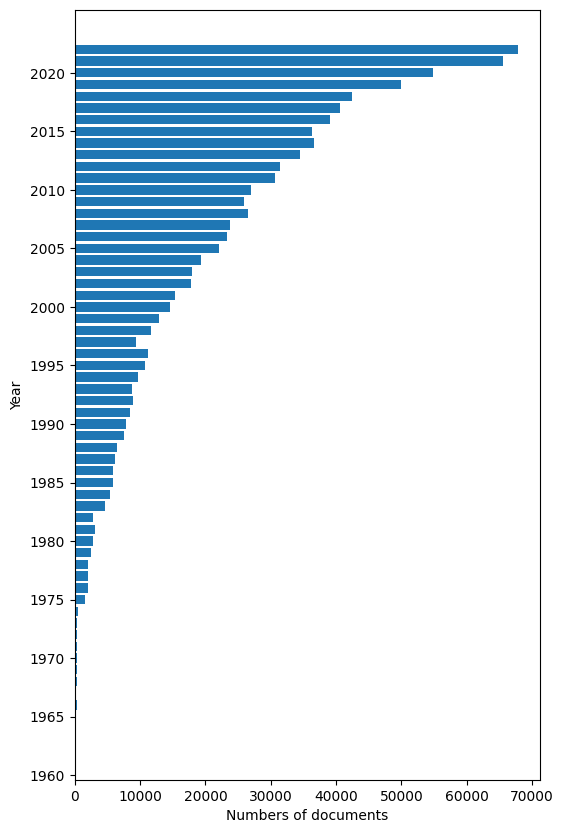

In [135]:
plt.figure(figsize=(6,10))
plt.barh(yeardf['Year'], yeardf['Count'])
plt.ylabel('Year')
plt.xlabel('Numbers of documents')
plt.yticks(range(1960, 2021, 5))

([<matplotlib.axis.YTick at 0x2b55ac655030>,
 [Text(0, 1960, '1960'),
  Text(0, 1965, '1965'),
  Text(0, 1970, '1970'),
  Text(0, 1975, '1975'),
  Text(0, 1980, '1980'),
  Text(0, 1985, '1985'),
  Text(0, 1990, '1990'),
  Text(0, 1995, '1995'),
  Text(0, 2000, '2000'),
  Text(0, 2005, '2005'),
  Text(0, 2010, '2010'),
  Text(0, 2015, '2015'),
  Text(0, 2020, '2020')])

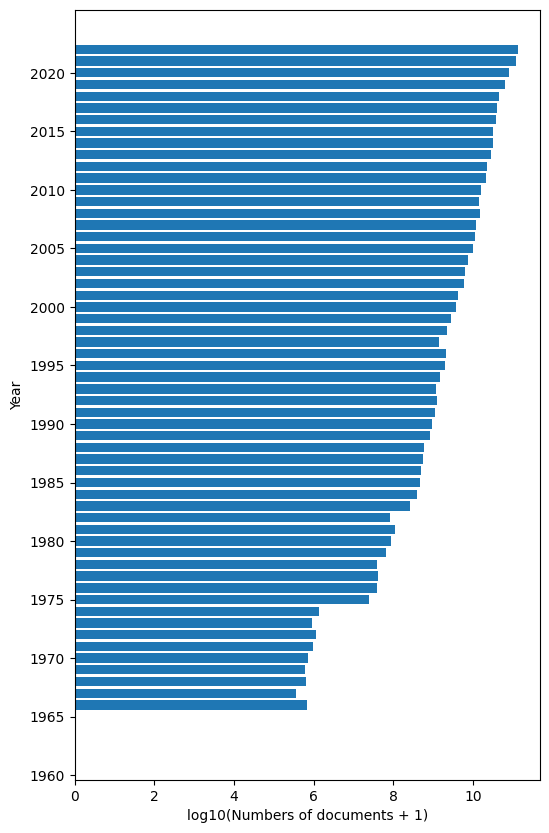

In [136]:
plt.figure(figsize=(6,10))
plt.barh(yeardf['Year'], np.log(yeardf['Count']))
plt.ylabel('Year')

# +1 so the x-axis value is not zero.
plt.xlabel('log10(Numbers of documents + 1)')
plt.yticks(range(1960, 2021, 5))

In [137]:
documents['Date'] = pd.to_datetime(data['Date'])
# documents['Timestamp'] = documents['Date'].dt.timestamp()
ts_for_bins = list(documents['Date'])
ts_for_bins.sort()

bin_num  = 20
bin_size = int(len(ts_for_bins)/bin_num)
bin_idxs = [idx for idx in range(0, len(ts_for_bins), bin_size)]

bin_timestamps = [ts_for_bins[idx] for idx in bin_idxs]

bin_df         = pd.DataFrame(list(zip(bin_idxs, bin_timestamps)),
            columns=['bin_start_idx', 'bin_start_date'])

bin_df['Count'] = bin_df['bin_start_idx'].diff().fillna(bin_df['bin_start_idx'].iloc[0]).astype(int)
bin_df['bin_end_date'] = bin_df['bin_start_date'].shift(-1) - pd.Timedelta(days=1)
bin_df['bin_end_date'][20] = max(documents['Date']) + pd.Timedelta(1, unit='D')

In [138]:
bin_period = []
documents['bin_period'] = 0

for i in tqdm(range(len(documents))):
    period = 0
    while documents['Date'][i] > bin_df['bin_end_date'][period] and period < len(bin_df):
        period +=1
     
        # doc = documents['Date'][i]
        # bindate = bin_df['bin_end_date'][period]

        # print(f'Period: {period}.. {doc} < {bindate}')

   # print(f'Assigning Document: {i} bin: {period}')
    documents['bin_period'][i] = period

        

  7%|▋         | 67606/938974 [00:16<03:38, 3979.84it/s]


KeyboardInterrupt: 

In [142]:
with open(dir_12/'new_docs.pickle', "wb") as f:
         pickle.dump(documents, f)

In [123]:
topic_frequency = documents.groupby('bin_period')['Topic'].value_counts().unstack(fill_value=0)
topic_frequency_norm = documents.groupby('Topic')['bin_period'].value_counts(normalize=True).unstack(fill_value=0)

#### heatmap

In [9]:
with open(dir_12/'new_docs.pickle', "rb") as f:
    docs_12 = pickle.load(f)

topics_over_time(docs_12, topic_info_12)

## 2400to2771

#### yearstuff

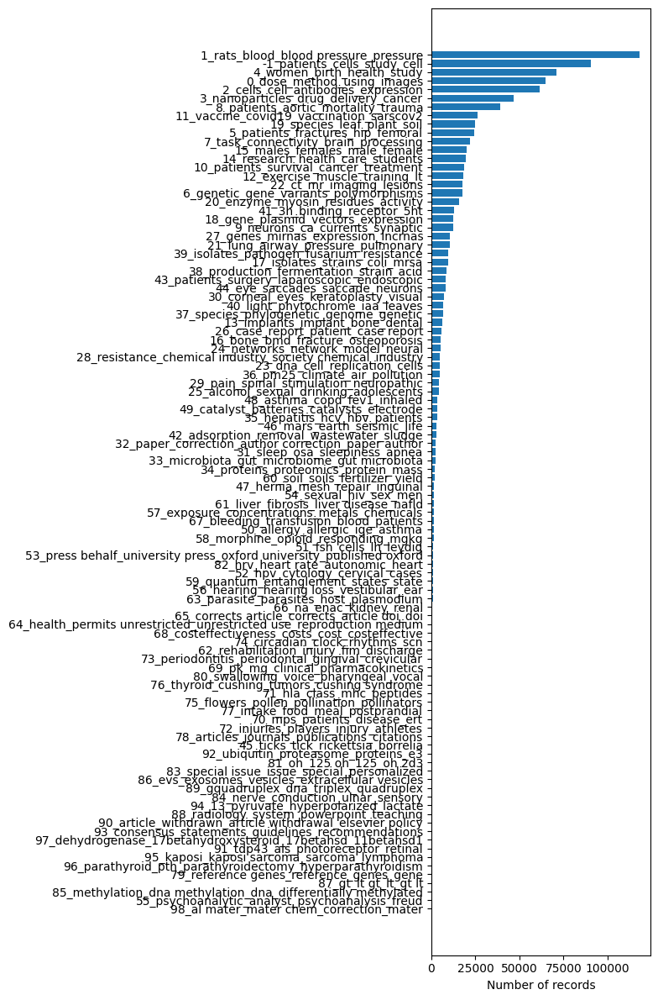

In [3]:
topic_info = topic_info_24
topic_info_sorted = topic_info.sort_values(by=['Count'])
topic_names  = list(topic_info_sorted.Name.values)
topic_counts = list(topic_info_sorted.Count.values)
y_pos        = len(topic_names)

plt.figure(figsize=(8,12))
plt.barh(topic_names, topic_counts)
#ax.set_yticks(y_pos, labels=topic_names)
plt.xlabel('Number of records')

plt.tight_layout()


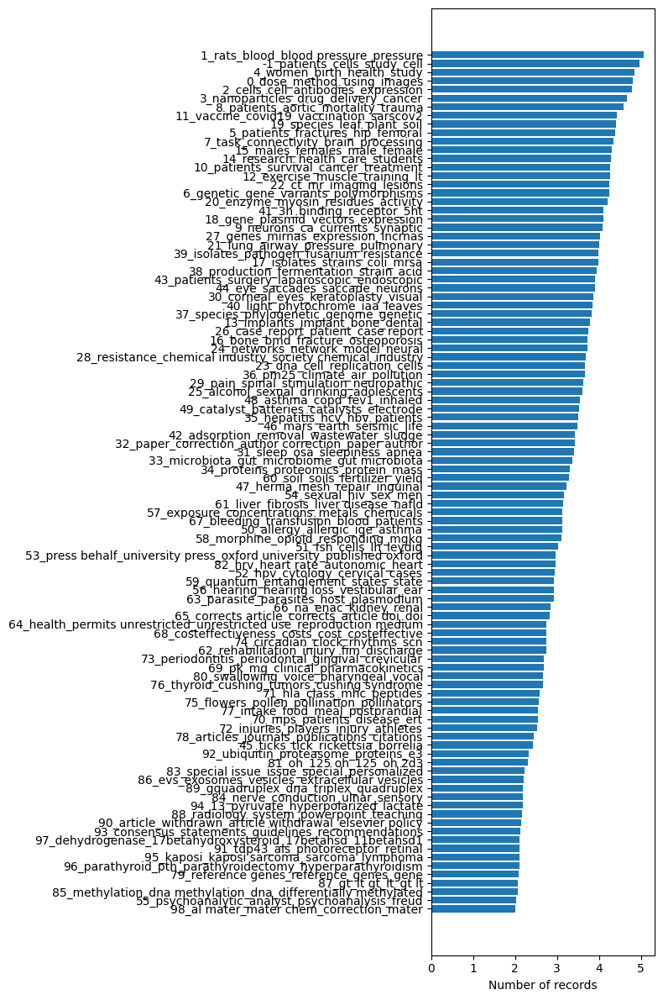

In [128]:
topic_info = topic_info_24
topic_info_sorted = topic_info.sort_values(by=['Count'])
topic_names  = list(topic_info_sorted.Name.values)
topic_counts = list(topic_info_sorted.Count.values)
y_pos        = len(topic_names)

plt.figure(figsize=(8,12))
plt.barh(topic_names, np.log10(topic_counts))
#ax.set_yticks(y_pos, labels=topic_names)
plt.xlabel('Number of records')
plt.tight_layout()
  #plt.savefig(outputfile4)

In [6]:
with open(dir_24/'documents.pickle', "rb") as f:
  documents = pickle.load(f)

In [ ]:
with open(dir_24/'new_docs.pickle', "rb") as f:
    documents = pickle.load(f)

In [7]:
data = pd.read_csv(csv_dir_24/'2400to2771_topjournals.csv', sep='\t')

In [8]:
topic_model = BERTopic.load(dir_24/'model_outliers_reduced')

Fri Mar 29 09:07:06 2024 Building and compiling search function


In [11]:
docs = expand_docs(documents, data, topic_model, dir_24)

100%|██████████| 938974/938974 [06:16<00:00, 2496.62it/s]


#### heatmap

In [6]:
documents['Year'] = pd.to_datetime(data['Date']).dt.year
documents['Journal'] = data['Journal']
documents = documents.drop(columns='ID')

for i in range(len(documents['Year'])):
    if documents['Year'][i] < 1960:
        documents['Year'][i] = 1959

yeardf = documents.groupby('Year').count()
yeardf['Count'] = yeardf['Journal']
yeardf = yeardf.drop(columns = ['Journal', 'Topic', 'Document'])
yeardf = yeardf.reset_index()

([<matplotlib.axis.YTick at 0x2b4283944b80>,
 [Text(0, 1960, '1960'),
  Text(0, 1965, '1965'),
  Text(0, 1970, '1970'),
  Text(0, 1975, '1975'),
  Text(0, 1980, '1980'),
  Text(0, 1985, '1985'),
  Text(0, 1990, '1990'),
  Text(0, 1995, '1995'),
  Text(0, 2000, '2000'),
  Text(0, 2005, '2005'),
  Text(0, 2010, '2010'),
  Text(0, 2015, '2015'),
  Text(0, 2020, '2020')])

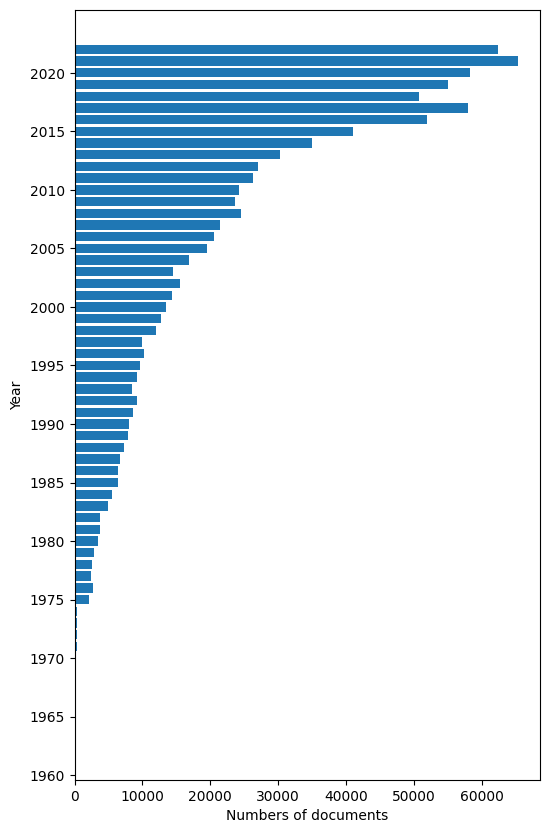

In [7]:
plt.figure(figsize=(6,10))
plt.barh(yeardf['Year'], yeardf['Count'])
plt.ylabel('Year')
plt.xlabel('Numbers of documents')
plt.yticks(range(1960, 2021, 5))

([<matplotlib.axis.YTick at 0x2b4283a9a2f0>,
 [Text(0, 1960, '1960'),
  Text(0, 1965, '1965'),
  Text(0, 1970, '1970'),
  Text(0, 1975, '1975'),
  Text(0, 1980, '1980'),
  Text(0, 1985, '1985'),
  Text(0, 1990, '1990'),
  Text(0, 1995, '1995'),
  Text(0, 2000, '2000'),
  Text(0, 2005, '2005'),
  Text(0, 2010, '2010'),
  Text(0, 2015, '2015'),
  Text(0, 2020, '2020')])

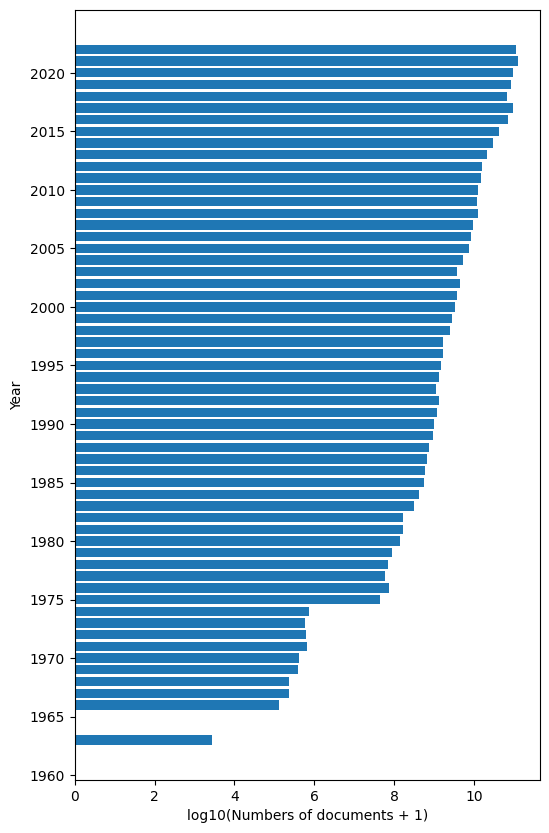

In [8]:
plt.figure(figsize=(6,10))
plt.barh(yeardf['Year'], np.log(yeardf['Count']))
plt.ylabel('Year')

# +1 so the x-axis value is not zero.
plt.xlabel('log10(Numbers of documents + 1)')
plt.yticks(range(1960, 2021, 5))

In [9]:
documents['Date'] = pd.to_datetime(data['Date'])
# documents['Timestamp'] = documents['Date'].dt.timestamp()
ts_for_bins = list(documents['Date'])
ts_for_bins.sort()

bin_num  = 20
bin_size = int(len(ts_for_bins)/bin_num)
bin_idxs = [idx for idx in range(0, len(ts_for_bins), bin_size)]

bin_timestamps = [ts_for_bins[idx] for idx in bin_idxs]

max_timestamp      = max(ts_for_bins) + pd.Timedelta(1, unit='D')

bin_df         = pd.DataFrame(list(zip(bin_idxs, bin_timestamps)),
            columns=['bin_start_idx', 'bin_start_date'])

bin_df['Count'] = bin_df['bin_start_idx'].diff().fillna(bin_df['bin_start_idx'].iloc[0]).astype(int)
bin_df['bin_end_date'] = bin_df['bin_start_date'].shift(-1) - pd.Timedelta(days=1)
bin_df['bin_end_date'][20] = max(documents['Date']) + pd.Timedelta(1, unit='D')



In [10]:
bin_period = []
documents['bin_period'] = 0

for i in tqdm(range(len(documents))):
    period = 0
    while documents['Date'][i] > bin_df['bin_end_date'][period] and period < len(bin_df):
        period +=1
     
        # doc = documents['Date'][i]
        # bindate = bin_df['bin_end_date'][period]

        # print(f'Period: {period}.. {doc} < {bindate}')

   # print(f'Assigning Document: {i} bin: {period}')
    documents['bin_period'][i] = period

with open(dir_24/'new_docs.pickle', "wb") as f:
         pickle.dump(documents, f)     
    

100%|██████████| 938974/938974 [06:14<00:00, 2507.11it/s]


NameError: name 'documents' is not defined

In [5]:
with open(dir_24/'new_docs.pickle', "rb") as f:
    documents = pickle.load(f)

EOFError: Ran out of input

In [11]:
topic_frequency = documents.groupby('bin_period')['Topic'].value_counts().unstack(fill_value=0)
topic_frequency_norm = documents.groupby('Topic')['bin_period'].value_counts(normalize=True).unstack(fill_value=0)

#### heatmap

In [11]:
with open(dir_24/'new_docs.pickle', "rb") as f:
    docs_24 = pickle.load(f)

topics_over_time(docs_24, topic_info_24)

## 3600to3938

#### general vis

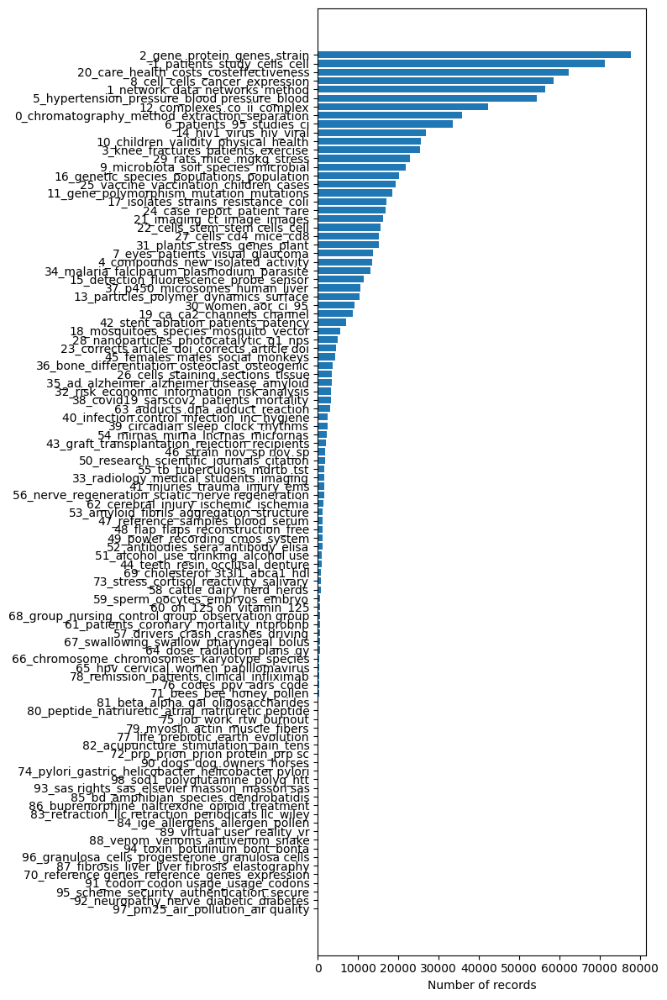

In [5]:
general_vis(topic_info_36)

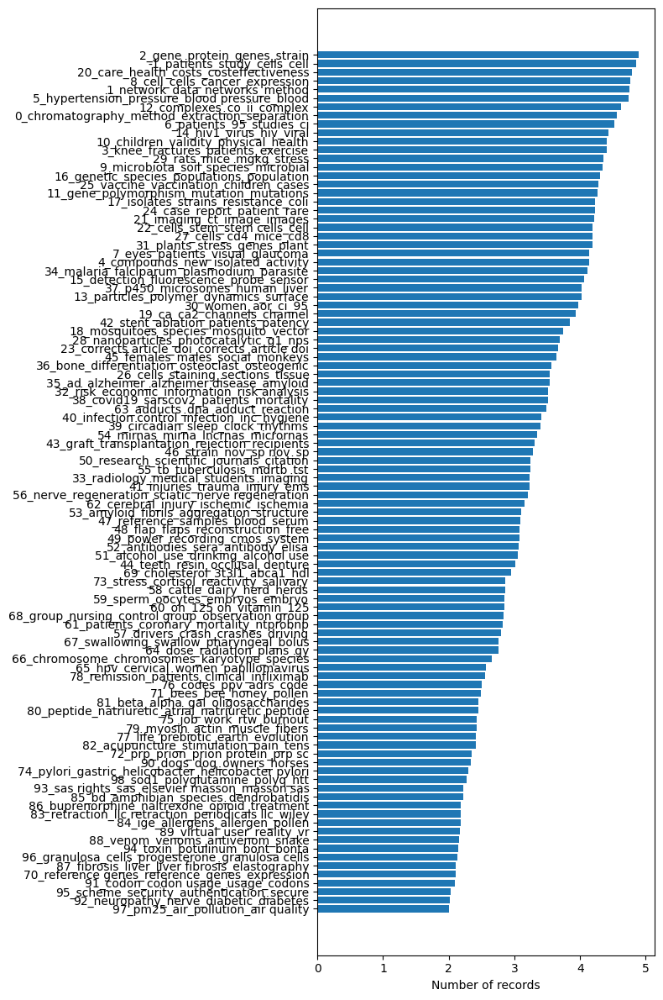

In [13]:
general_vis_log(topic_info_36)

In [14]:
with open(dir_36/'documents.pickle', "rb") as f:
  documents = pickle.load(f)

In [15]:
data = pd.read_csv(csv_dir_36/'3600to3938_topjournals.csv', sep='\t')

In [16]:
topic_model = BERTopic.load(dir_36/'model_outliers_reduced')

Fri Mar 29 09:37:23 2024 Building and compiling search function


In [17]:
docs_36 = expand_docs(documents, data, topic_model, dir_36)

100%|██████████| 948317/948317 [06:27<00:00, 2446.58it/s] 


Docs saved at: /mnt/scratch/ande2472/sjrouts/3600to3938_topjournals


#### heatmap

In [12]:
with open(dir_36/'new_docs.pickle', "rb") as f:
    docs_36 = pickle.load(f)

topics_over_time(docs_36, topic_info_36)

## 4800to5418

#### general vis

In [7]:
with open(dir_48/'documents.pickle', "rb") as f:
  documents = pickle.load(f)
data = pd.read_csv(csv_dir_48/'4800to5418_topjournals.csv', sep='\t')
topic_model = BERTopic.load(dir_48/'model_outliers_reduced')

Fri Mar 29 10:03:06 2024 Building and compiling search function


In [8]:
docs_48 = expand_docs(documents, data, topic_model, dir_48)

100%|██████████| 957831/957831 [06:20<00:00, 2517.40it/s]


Docs saved at: /mnt/scratch/ande2472/sjrouts/4800to5418_topjournals


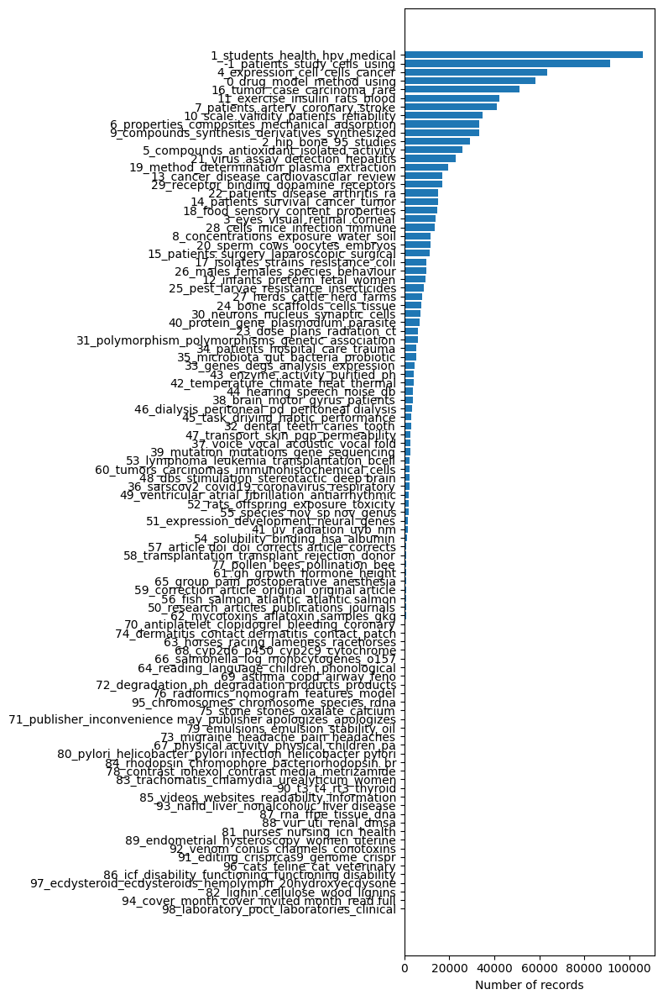

In [9]:
general_vis(topic_info_48)

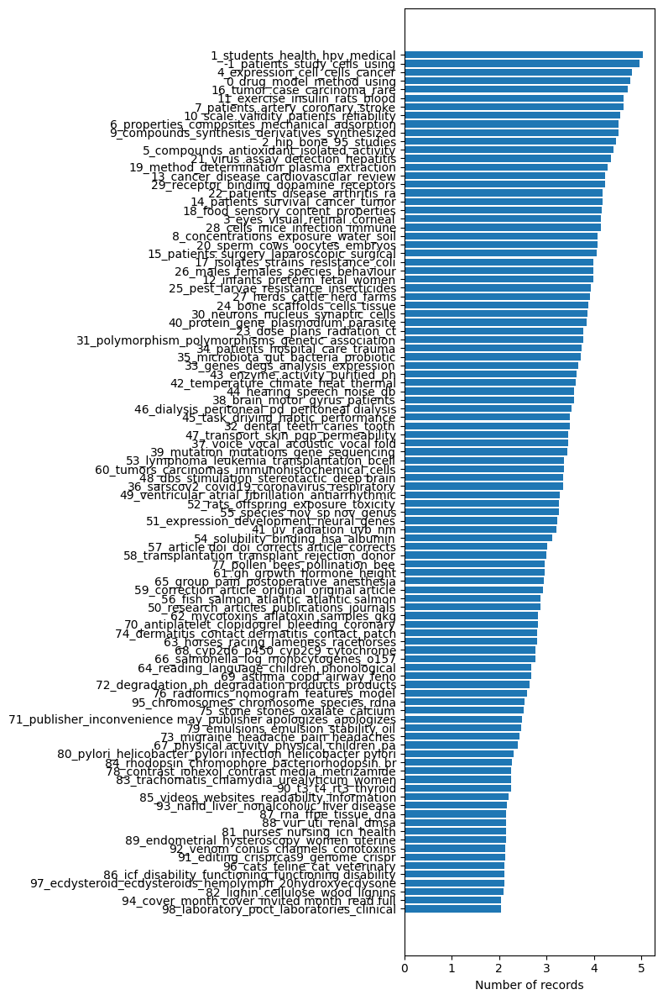

In [10]:
general_vis_log(topic_info_48)

#### heatmap

In [13]:
with open(dir_48/'new_docs.pickle', "rb") as f:
    docs_48 = pickle.load(f)

topics_over_time(docs_48, topic_info_48)


## Heatmaps

In [91]:
# with open(dir_0/'predictions.pickle', "rb") as f:
#   pred_0 = pickle.load(f)
with open(dir_12/'predictions.pickle', "rb") as f:
  pred_12 = pickle.load(f)

In [10]:
with open(dir_12/'new_docs.pickle', "rb") as f:
    documents_12 = pickle.load(f)

In [11]:
documents_12

,Document,Topic,Year,Journal,Date,bin_period
0,serum haemagglutinating property dependent upo...,5,1975,British journal of haematology,1975-11-01,0
1,effect human erythrocyte stromata complement a...,-1,1975,British journal of haematology,1975-09-01,0
2,effect o-salicylate upon pentose phosphate pat...,77,1975,British journal of haematology,1975-11-01,0
3,characteristics gastric inhibition acidificati...,36,1975,The Journal of physiology,1975-12-01,0
4,influence ph equilibrium effects tetrodotoxin ...,12,1975,The Journal of physiology,1975-12-01,0
...,...,...,...,...,...,...
926955,"sex , age , regional differences chrm1 chrm3 g...",1,2021,Current neuropharmacology,2021-12-04,19
926956,brain proteome-wide association study linking-...,-1,2021,Annals of clinical and translational neurology,2021-12-04,19
926957,detection interaction rna aptamer target compo...,-1,2021,"Chemical communications (Cambridge, England)",2021-12-04,19
926958,"stereoselective synthesis 1,6-diazecanes tande...",0,2021,"Chemical communications (Cambridge, England)",2021-12-04,19


In [18]:
embs_12.shape

(926960, 768)

In [17]:
with open('/mnt/scratch/ande2472/data/1200_topjournals/1200to1526_topjournals_embs.pickle', "rb") as f:
    embs_12 = pickle.load(f)

In [19]:
pred_12, prob_12 = topic_model.transform(list(documents_12['Document']), embeddings = embs_12)

: 

: 

### functions

In [12]:
def converttopicdf(topics_list):
    topic_dict = {}
    for index, topic in enumerate(topics_list):
        if topic not in topic_dict:
            topic_dict[topic] = []
        topic_dict[topic].append(index)
    df = pd.DataFrame(topic_dict.items(), columns=['topic', 'document_indices'])
    df['topic_length'] = df['document_indices']
    for i in range(len(df)):
     df['topic_length'][i] = len(df['document_indices'][i])
    return df



In [13]:
    # Initialize an empty similarity matrix
def calculate_similarity_matrix(topic1, topic2):
    
 matrix = np.zeros((len(topic1),len(topic2)))

    # Calculate the Jaccard similarity between each pair of topics
 for i in range(len(topic1)):
        for j in range(len(topic2)):
            docs1 = set(topic1[topic1['topic'] == topic1['topic'][i]]['document_indices'].iloc[0])
            docs2 = set(topic2[topic2['topic'] == topic2['topic'][j]]['document_indices'].iloc[0])
            intersection = len(docs1.intersection(docs2))
            union = len(docs1.union(docs2))
            matrix[i, j] = intersection / union
    
 return matrix

In [14]:

#sort matrix for heatmaps
def sort_singularity_mat(matrix):
    max_values = np.max(matrix, axis=1)
    sorted_indices = np.argsort(max_values)[::-1]
    sorted_similarity_matrix = matrix[sorted_indices]
    max_values_col = np.max(sorted_similarity_matrix, axis=0)
    sorted_indices_col = np.argsort(max_values_col)[::-1]
    sorted_similarity_matrix2 = sorted_similarity_matrix[:, sorted_indices_col]
    return sorted_similarity_matrix2

### heatmaps

In [14]:
with open(dirf_0/'full_generated_model', "rb") as f:
  topic_model_0 = pickle.load(f)

IsADirectoryError: [Errno 21] Is a directory: '/mnt/scratch/ande2472/sjrouts/0to264_full/full_generated_model'

In [10]:
topic_model_0 = BERTopic.load(dirf_0/'full_generated_model/0to264_topjournals_embs_generated_model')

KeyboardInterrupt: 

In [11]:
topic_model_12 = BERTopic.load(dirf_12/'full_generated_model/1200to1526_topjournals_embs_generated_model')

In [18]:
topic_model_0.get_topic_info()

,Topic,Count,Name,Representation,KeyBERT,MMR,Representative_Docs
0,-1,619424,-1_cells_patients_cell_protein,"[cells, patients, cell, protein, expression, d...","[binding, proteins, receptor, blood, activatio...","[cell, protein, expression, human, gene, cance...",[interleukin 10 ( il-10 ) upregulates function...
1,0,16394,0_patients_mg_dose_survival,"[patients, mg, dose, survival, chemotherapy, m...","[progression free, patients received, overall ...","[mg, dose, survival, chemotherapy, cancer, tox...",[three-week schedule gemcitabine-cisplatin adv...
2,1,15796,1_arabidopsis_membrane_protein_proteins,"[arabidopsis, membrane, protein, proteins, pla...","[endoplasmic reticulum, arabidopsis thaliana, ...","[arabidopsis, protein, proteins, plants, auxin...",[novel putative auxin carrier family regulates...
3,2,15378,2_data_database_protein_http,"[data, database, protein, http, web, genome, i...","[3d, annotation, user, high throughput, web se...","[database, protein, genome, information, gene,...",[tissuenexus : database human tissue functiona...
4,3,14892,3_catalyzed_reaction_synthesis_enantioselective,"[catalyzed, reaction, synthesis, enantioselect...","[alkynes, cyclization, palladium catalyzed, al...","[enantioselective, reactions, aryl, wiley vch,...",[enantioselective cobalt-catalyzed hydroborati...
...,...,...,...,...,...,...,...
95,94,167,94_gt_gt lt_lt_sub gt,"[gt, gt lt, lt, sub gt, lt sub, lt sup, sup gt...","[lt gt, gt lt, sub, sub gt, gt, lt sub, nd lt,...","[gt, gt lt, sub gt, lt sub, lt sup, lt gt, fe ...",[photoelectrocatalytic reforming polyol-based ...
96,95,159,95_urology_association urology_urology publish...,"[urology, association urology, urology publish...","[urology, bladder, 2017 european, urological, ...","[urology, association urology, european associ...",[reducing prostate cancer deaths : unsupported...
97,96,157,96_computer_program_sequences_sequence,"[computer, program, sequences, sequence, progr...","[computer program, analysis program, microcomp...","[computer, program, sequence, dna, microcomput...",[computer programs nucleic acid sequence manip...
98,97,150,97_cyclic_monophosphate_adenosine_adenosine mo...,"[cyclic, monophosphate, adenosine, adenosine m...","[guanosine monophosphate, adenosine monophosph...","[monophosphate, adenosine monophosphate, cycli...","[inhibition cell growth vitro adenosine 3',5'-..."


In [19]:
embeddings = topic_model_0.c_tf_idf_[topic_model_0._outliers:]
embeddings2 = topic_model_12.c_tf_idf_[topic_model_12._outliers:]

In [20]:
freq_df = topic_freq_0.loc[topic_freq_0.Topic != -1, :]
freq_df2 = topic_freq_12.loc[topic_freq_12.Topic != -1, :]

In [21]:
topics = sorted(freq_df.Topic.to_list())
topics2 = sorted(freq_df2.Topic.to_list())

In [30]:
embeddings

<99x30737149 sparse matrix of type '<class 'numpy.float64'>'
	with 25525467 stored elements in Compressed Sparse Row format>

In [32]:
embeddings2

<99x32788409 sparse matrix of type '<class 'numpy.float64'>'
	with 29070412 stored elements in Compressed Sparse Row format>

In [51]:
embeddings = csr_matrix(embeddings)

In [52]:
embeddings2 = csr_matrix(embeddings2)

In [ ]:
safe_sparse_dot(sparse1,sparse2.T)

In [53]:
def gpu_cosine_similarity(matrix, matrix2):
    #sparse = csr_matrix(matrix)
    norm = Normalizer()
    norm_matrix = norm.transform(matrix)
    norm_matrix2 = norm.transform(matrix2)
    K = safe_sparse_dot(norm_matrix.T, norm_matrix2, dense_output=True) 
    return K

In [27]:
import scipy.sparse as sp
sparse1 = sp.csr_matrix([[1,2],[2,1],[2,1]])
sparse2 = sp.csr_matrix([[1,2],[2,1],[2,1],[2,1],[2,1]])

In [34]:
sparse1.T

<2x3 sparse matrix of type '<class 'numpy.int64'>'
	with 6 stored elements in Compressed Sparse Column format>

In [35]:
sparse2.T

<2x5 sparse matrix of type '<class 'numpy.int64'>'
	with 10 stored elements in Compressed Sparse Column format>

In [44]:
safe_sparse_dot(sparse1,sparse2.T)

<3x5 sparse matrix of type '<class 'numpy.int64'>'
	with 15 stored elements in Compressed Sparse Row format>

In [41]:
embeddings2.T.shape

(39418010, 99)

In [55]:
distance_matrix = gpu_cosine_similarity(embeddings.T, embeddings2.T)

ValueError: This algorithm does not support the sparse input in the current configuration.

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98])

In [31]:
topic_model_0.topic_aspects_["OpenAI"]


KeyError: 'OpenAI'

In [18]:
words = topic_model_0.vectorizer_model.get_feature_names_out()

In [21]:
words_12 = topic_model_12.vectorizer_model.get_feature_names_out()

In [5]:

from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance, OpenAI, PartOfSpeechimport openai

In [8]:



# KeyBERT
keybert_model = KeyBERTInspired()

# Part-of-Speech
#pos_model = PartOfSpeech("en_core_web_sm")

# MMR
mmr_model = MaximalMarginalRelevance(diversity=0.3)

# GPT-3.5
client = openai.OpenAI(api_key="sk-...")
prompt = """
I have a topic that contains the following documents: 
[DOCUMENTS]
The topic is described by the following keywords: [KEYWORDS]

Based on the information above, extract a short but highly descriptive topic label of at most 5 words. Make sure it is in the following format:
topic: <topic label>
"""
aimodel = "gpt-3.5-turbo"
openai_model = OpenAI(client, exponential_backoff=True, chat=True, prompt=prompt)

# All representation models
representation_model = {
    "KeyBERT": keybert_model,
    "OpenAI": openai_model,  # Uncomment if you will use OpenAI
    "MMR": mmr_model,
  #  "POS": pos_model
}

In [9]:
topic_model_0.update_topics(docs_0['Document'], top_n_words=20, representation_model= representation_model)

AttributeError: 'NoneType' object has no attribute 'embed_documents'

In [20]:
words.shape

(36828274,)

In [94]:
topic_vec_0 = converttopicdf(pred_0)
topic_vec_12 = converttopicdf(pred_12)

In [95]:
similarity_matrix_0_12 = calculate_similarity_matrix(topic_vec_0, topic_vec_12)
sorted_similarity_matrix_0_12 = sort_singularity_mat(similarity_matrix_0_12)

In [103]:
sorted_similarity_matrix_0_12

array([[4.42132787e-01, 2.59372343e-02, 2.17316912e-02, ...,
        2.07656875e-04, 1.77765472e-04, 1.03829908e-04],
       [3.67311703e-02, 1.73011507e-02, 1.38408908e-02, ...,
        1.89092088e-04, 8.10613635e-05, 1.35332648e-04],
       [2.56815129e-02, 1.55485228e-02, 1.30363001e-02, ...,
        2.29182582e-04, 1.14639459e-04, 1.53215613e-04],
       ...,
       [4.81027903e-05, 3.88018004e-05, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [1.81732337e-04, 0.00000000e+00, 1.40219677e-04, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.38491468e-05, 0.00000000e+00, 4.68099050e-05, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00]])

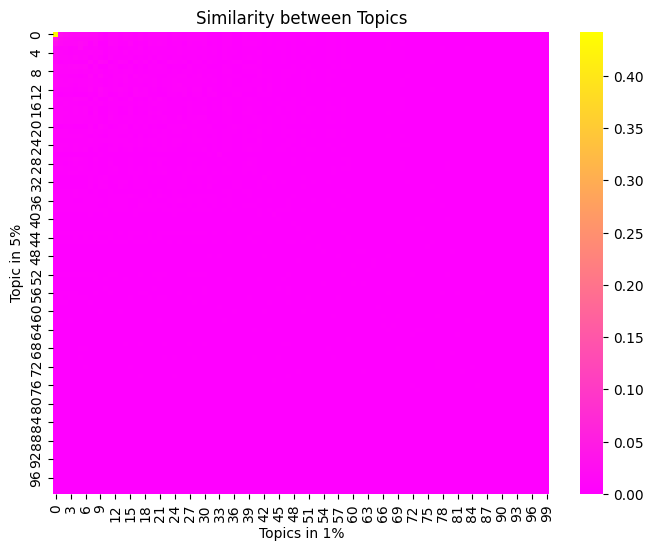

In [104]:
# Create a heatmap
plt.figure(figsize=(8, 6))
plt.axes().set_facecolor("blue")
sns.heatmap(sorted_similarity_matrix_0_12, cmap='spring', )

plt.xlabel('Topics in 1%')
plt.ylabel('Topic in 5%')
plt.title('Similarity between Topics')
plt.show()

In [1]:
from cuml.preprocessing import Normalizer
from sklearn.utils.extmath import safe_sparse_dot


In [50]:
from scipy.sparse import csr_matrix

In [6]:
mat_1 = np.array([[2,2,3],[2,2,3],[2,2,3],[2,2,3],[2,2,3]])

In [7]:
mat_2 = np.array([[2,2,3],[2,2,3],[2,2,3],[2,2,3],[2,2,3],[2,2,3],[2,2,3]])

In [1]:
mat_1.T

NameError: name 'mat_1' is not defined

## Fixing outliers

,Document,ID,Topic
0,involvement small intestine systemic mast cell...,0,0
1,gastric ph microflora normal diarrhoeic infant...,1,-1
2,"structure , composition , physical properties ...",2,-1
3,localization nadh oxidase surface human polymo...,3,29
4,defective lysosomal enzyme secretion kidneys c...,4,-1
...,...,...,...
974819,method low-coverage single-gamete sequence ana...,974819,-1
974820,destabilizers thymidylate synthase homodimer a...,974820,-1
974821,edna-stimulated cell dispersion caulobacter cr...,974821,66
974822,weakly migratory metastatic breast cancer cell...,974822,-1


In [13]:
with open("/mnt/scratch/ande2472/sjrouts/0to264_full/generated_topics/0to264_topjournals_embs_generated_topics.pickle", "rb") as f:
    topics = pickle.load(f)

In [16]:
prob_file = '/mnt/scratch/ande2472/sjrouts/0to264_full/generated_probabilities/0to264_topjournals_embs_generated_probabilities.pickle'
with open(prob_file, "rb") as f:
    prob = pickle.load(f)

In [10]:
dir_0full = Path('/mnt/scratch/ande2472/sjrouts/0to264_full/')
dir_12full = Path('/mnt/scratch/ande2472/sjrouts/1200to1526_full/')
dir_24full = Path('/mnt/scratch/ande2472/sjrouts/2400to2771_full/')
dir_36full = Path('/mnt/scratch/ande2472/sjrouts/3600to3938_full/')
dir_48full = Path('/mnt/scratch/ande2472/sjrouts/4800to5418_full/')


In [10]:

topic_model_0 = BERTopic.load(dir_0full/'model_outliers_reduced')

In [13]:
topic_model_12 = BERTopic.load(dir_12full/'model_outliers_reduced')

In [11]:
topic_model_24 = BERTopic.load(dir_24full/'model_outliers_reduced')
topic_model_36 = BERTopic.load(dir_36full/'model_outliers_reduced')
topic_model_48 = BERTopic.load(dir_48full/'model_outliers_reduced')

In [13]:
with open(dir_0full/'new_docs.pickle', "rb") as f:
  docs_0 = pickle.load(f)
with open(dir_12full/'new_docs.pickle', "rb") as f:
  docs_12 = pickle.load(f)

In [37]:
docs_0.groupby('bin_period')['Year'].value_counts()[19].sort_index()

Year
2021     4054
2022    44828
Name: Year, dtype: int64

In [14]:


#matrix = topics_over_time(docs_0, list(topic_info_0['Name']))

In [11]:
topic_labels = topic_model_0.generate_topic_labels(nr_words=4, word_length=15, aspect="MMR", separator='|')
topic_labels2 = topic_model_0.generate_topic_labels(nr_words=3, word_length=20, aspect="KeyBERT", separator='|')

In [73]:
matrix = topics_over_time(docs_0, topic_labels2, title=None, save_img="plots/topic_over_time_0.png")

In [20]:
topic_frequency_norm = docs_0.groupby('Topic')['bin_period'].value_counts(normalize=True).unstack(fill_value=0)
topic_frequency_norm

bin_period,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
Topic,,,,,,,,,,,,,,,,,,,,,
-1,0.057752,0.063688,0.067521,0.063388,0.060288,0.058390,0.053900,0.050256,0.050500,0.046799,...,0.042384,0.042440,0.043680,0.042121,0.040824,0.044338,0.040824,0.043210,0.045239,0.000000
0,0.003918,0.024795,0.052271,0.076757,0.078612,0.079282,0.068715,0.074746,0.069230,0.067581,...,0.056498,0.044023,0.040724,0.036754,0.035930,0.029022,0.034641,0.030053,0.032064,0.000000
1,0.006269,0.018371,0.045664,0.065488,0.069613,0.070031,0.062762,0.057983,0.060564,0.056275,...,0.051914,0.053622,0.050515,0.048753,0.048698,0.047372,0.045791,0.043483,0.043083,0.000000
2,0.022117,0.012584,0.012913,0.015800,0.021461,0.031568,0.047007,0.056113,0.067582,0.067910,...,0.061479,0.062775,0.063612,0.062004,0.062890,0.063415,0.065482,0.071586,0.067188,0.000033
3,0.000453,0.000323,0.000194,0.000323,0.000711,0.008601,0.043197,0.052638,0.047271,0.059364,...,0.062985,0.080639,0.096029,0.093443,0.094219,0.084907,0.078182,0.068029,0.070422,0.000065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,0.000000,0.000000,0.000000,0.006536,0.000000,0.006536,0.006536,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.006536,0.000000,0.019608,0.006536,0.006536,0.202614,0.738562,0.000000
95,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.141667,0.150000,0.150000,0.083333,0.116667,0.150000,0.083333,0.125000,0.000000
96,0.061069,0.549618,0.335878,0.022901,0.015267,0.000000,0.015267,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [15]:
#docs_12
topic_frequency_norm = docs_0.groupby('Topic')['bin_period'].value_counts(normalize=True).unstack(fill_value=0)

In [90]:
len(topic_frequency_norm.columns)

21

In [17]:
topic_labels_12 = topic_model_12.generate_topic_labels(nr_words=3, word_length=20, aspect="KeyBERT", separator='|')
matrix_12 = topics_over_time(docs_12, topic_labels_12, title="Top 5% Over Time", save_img="plots/topic_over_time_1200.png")

In [18]:
with open(dir_24full/'new_docs.pickle', "rb") as f:
  docs_24 = pickle.load(f)
topic_labels_24 = topic_model_24.generate_topic_labels(nr_words=3, word_length=20, aspect="KeyBERT", separator='|')
matrix_24 = topics_over_time(docs_24, topic_labels_24, title="Top 10% Over Time", save_img="plots/topic_over_time_2400.png")

In [17]:
with open(dir_36full/'new_docs.pickle', "rb") as f:
  docs_36 = pickle.load(f)
topic_labels_36 = topic_model_36.generate_topic_labels(nr_words=3, word_length=20, aspect="KeyBERT", separator='|')
matrix_36= topics_over_time(docs_36, topic_labels_36, title="Top 15% Over Time", save_img="plots/topic_over_time_3600.png")

In [20]:
with open(dir_48full/'new_docs.pickle', "rb") as f:
  docs_48 = pickle.load(f)
topic_labels_48 = topic_model_48.generate_topic_labels(nr_words=3, word_length=20, aspect="KeyBERT", separator='|')
matrix_48= topics_over_time(docs_48, topic_labels_48, title="Top 20% Over Time", save_img="plots/topic_over_time_4800.png")

In [54]:
embeddings = topic_model_0.c_tf_idf_[topic_model_0._outliers:]
embeddings2 = topic_model_12.c_tf_idf_[topic_model_12._outliers:]

In [112]:
topic_model_0.find_topics('dejoadaehdiueajoefi', top_n=100)[1]

[0.6327980840212846,
 0.6033669603206638,
 0.5927780684319148,
 0.5898855590649856,
 0.5866240298587073,
 0.5842408077852613,
 0.5839786191286358,
 0.5830103010950629,
 0.5793454511522457,
 0.5789468867976459,
 0.5747218218290795,
 0.5736708885872648,
 0.5730506197629072,
 0.5725060245507474,
 0.5716386947964737,
 0.5715429845656683,
 0.5713193038742292,
 0.5704842198006295,
 0.570359907808272,
 0.5693755080117074,
 0.5693060015330883,
 0.5688862424669354,
 0.5686856768799593,
 0.5686621388484909,
 0.5635533585936852,
 0.5630968852573615,
 0.5629283742640563,
 0.5627516426225242,
 0.5625107533737699,
 0.5616628675008002,
 0.5615675665342776,
 0.5615144539410806,
 0.5604068497762453,
 0.560124844380925,
 0.5601084763769393,
 0.5599563851197376,
 0.5593099817852829,
 0.5589239001787353,
 0.5581146731286336,
 0.5580575302985158,
 0.5579238448981371,
 0.557816250344246,
 0.5572029242603938,
 0.5569027999929725,
 0.5568994631968454,
 0.5560128251495364,
 0.555644999375742,
 0.55556642061505

In [116]:
doc_path = Path('/mnt/scratch/ande2472/data/1200_topjournals')
with open(doc_path/'1200to1526_topjournals_cleans.pickle', "rb") as f:
    cleans_12 = pickle.load(f)

In [60]:
predictions_12, probs_12 = topic_model_0.transform(cleans_12)

(99, 30737149)

In [126]:
topic_info_0

,Topic,Count,Name,Representation,KeyBERT,MMR,Representative_Docs
0,-1,53228,-1_cells_patients_cell_protein,"['cells', 'patients', 'cell', 'protein', 'expr...","['binding', 'proteins', 'receptor', 'blood', '...","['cell', 'protein', 'expression', 'human', 'ge...",['interleukin 10 ( il-10 ) upregulates functio...
1,0,19399,0_patients_mg_dose_survival,"['patients', 'mg', 'dose', 'survival', 'chemot...","['progression free', 'patients received', 'ove...","['mg', 'dose', 'survival', 'chemotherapy', 'ca...",['three-week schedule gemcitabine-cisplatin ad...
2,1,55033,1_arabidopsis_membrane_protein_proteins,"['arabidopsis', 'membrane', 'protein', 'protei...","['endoplasmic reticulum', 'arabidopsis thalian...","['arabidopsis', 'protein', 'proteins', 'plants...",['novel putative auxin carrier family regulate...
3,2,60948,2_data_database_protein_http,"['data', 'database', 'protein', 'http', 'web',...","['3d', 'annotation', 'user', 'high throughput'...","['database', 'protein', 'genome', 'information...",['tissuenexus : database human tissue function...
4,3,15464,3_catalyzed_reaction_synthesis_enantioselective,"['catalyzed', 'reaction', 'synthesis', 'enanti...","['alkynes', 'cyclization', 'palladium catalyze...","['enantioselective', 'reactions', 'aryl', 'wil...",['enantioselective cobalt-catalyzed hydroborat...
...,...,...,...,...,...,...,...
95,94,153,94_gt_gt lt_lt_sub gt,"['gt', 'gt lt', 'lt', 'sub gt', 'lt sub', 'lt ...","['lt gt', 'gt lt', 'sub', 'sub gt', 'gt', 'lt ...","['gt', 'gt lt', 'sub gt', 'lt sub', 'lt sup', ...",['photoelectrocatalytic reforming polyol-based...
96,95,120,95_urology_association urology_urology publish...,"['urology', 'association urology', 'urology pu...","['urology', 'bladder', '2017 european', 'urolo...","['urology', 'association urology', 'european a...",['reducing prostate cancer deaths : unsupporte...
97,96,131,96_computer_program_sequences_sequence,"['computer', 'program', 'sequences', 'sequence...","['computer program', 'analysis program', 'micr...","['computer', 'program', 'sequence', 'dna', 'mi...",['computer programs nucleic acid sequence mani...
98,97,121,97_cyclic_monophosphate_adenosine_adenosine mo...,"['cyclic', 'monophosphate', 'adenosine', 'aden...","['guanosine monophosphate', 'adenosine monopho...","['monophosphate', 'adenosine monophosphate', '...","[""inhibition cell growth vitro adenosine 3',5'..."


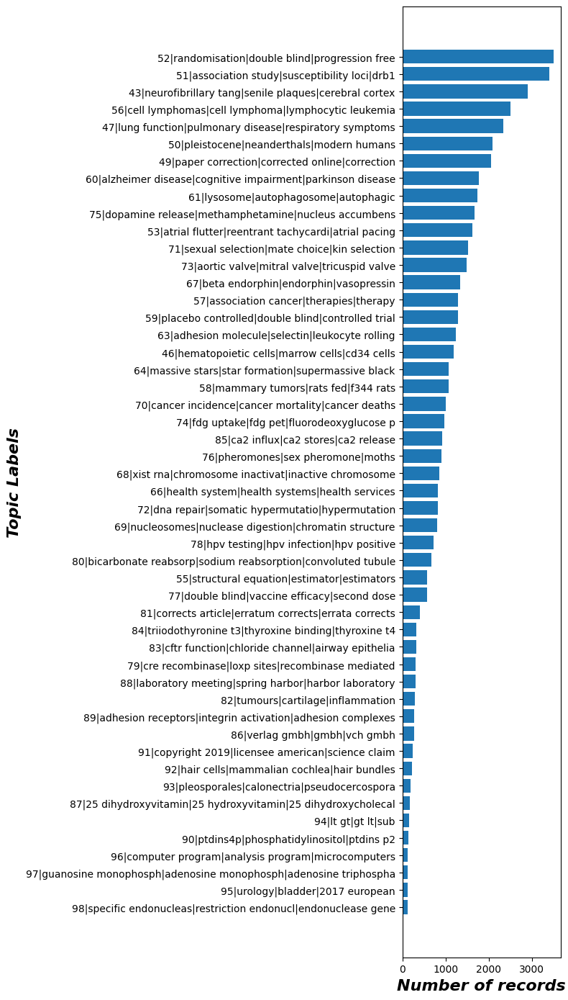

In [79]:
general_vis(topic_info_0, save_file='plots/topic_popularity_0.pdf', title = None, labels= topic_labels2)

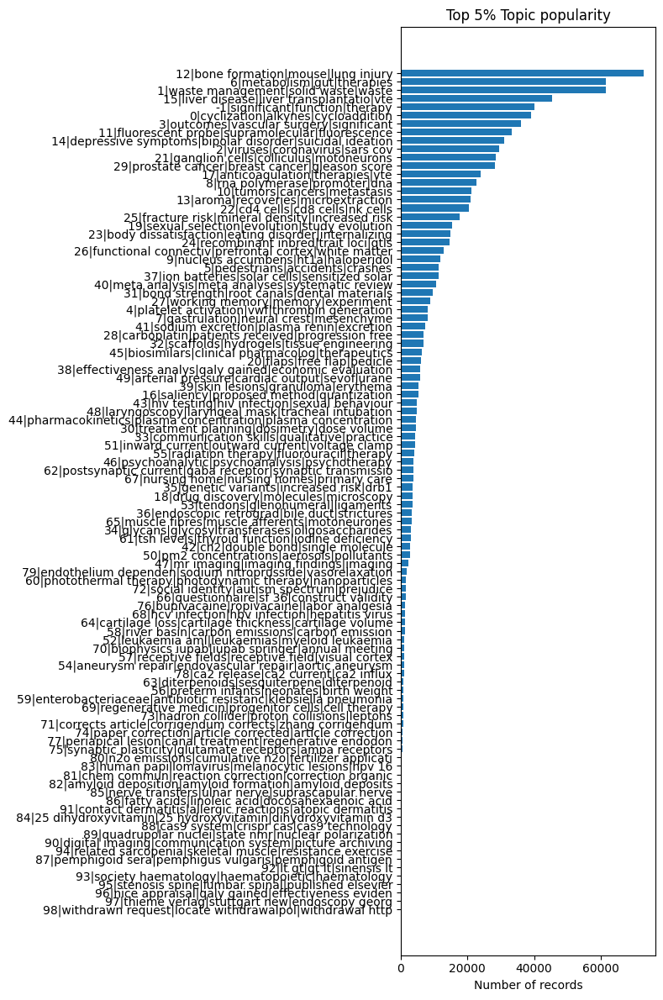

In [23]:
general_vis(topic_info_12, save_file='plots/topic_popularity_1200', title = "Top 5% Topic popularity", labels= topic_labels_12)

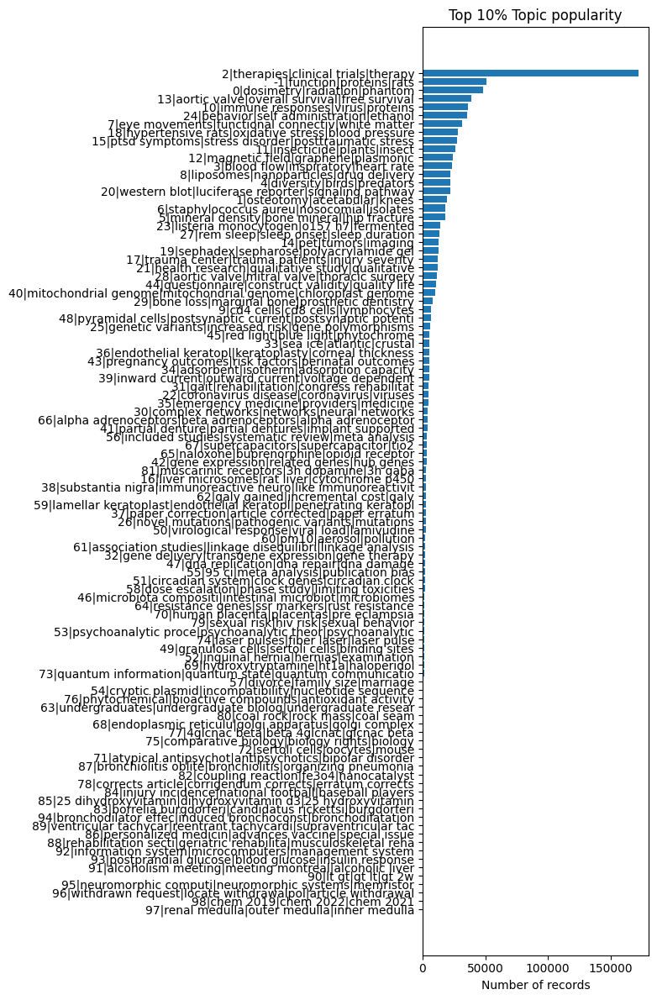

In [24]:
general_vis(topic_info_24, save_file='plots/topic_popularity_2400', title = "Top 10% Topic popularity", labels= topic_labels_24)

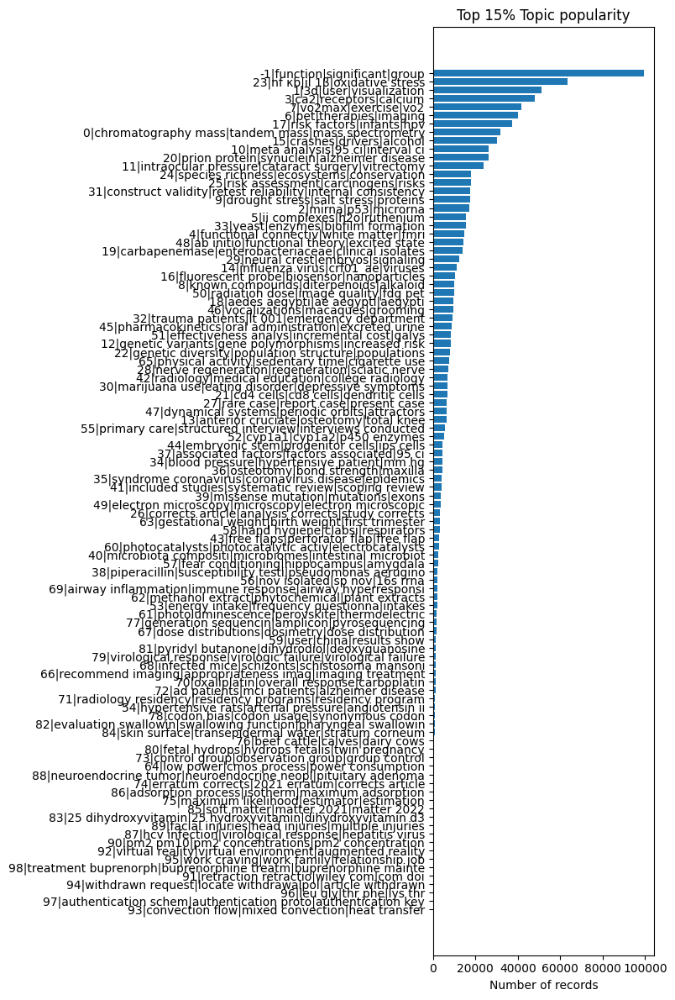

In [25]:
general_vis(topic_info_36, save_file='plots/topic_popularity_3600', title = "Top 15% Topic popularity", labels= topic_labels_36)

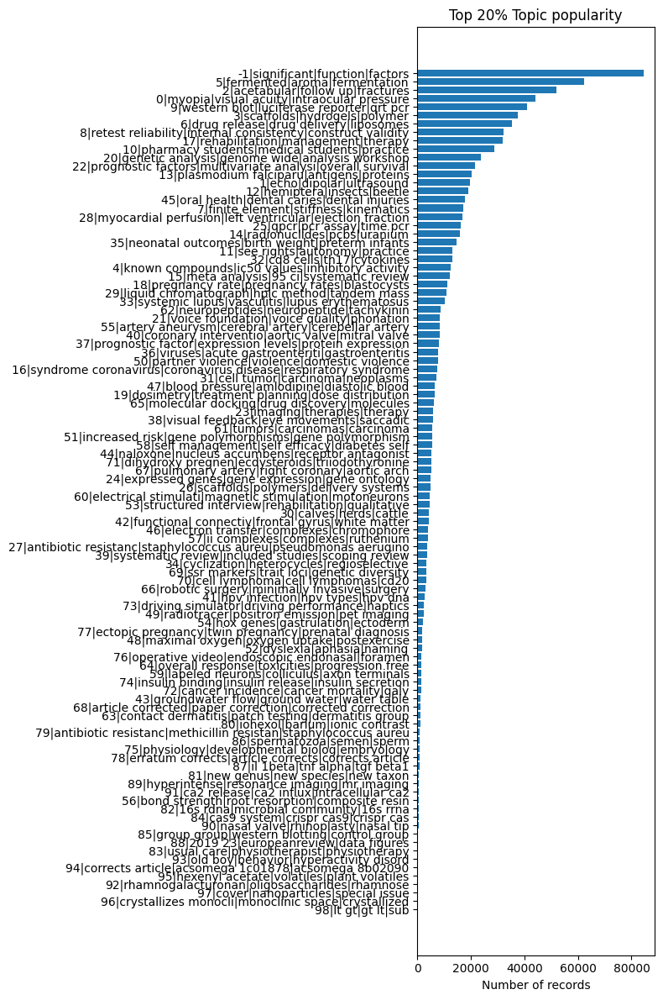

In [26]:
general_vis(topic_info_48, save_file='plots/topic_popularity_4800', title = "Top 20% Topic popularity", labels= topic_labels_48)

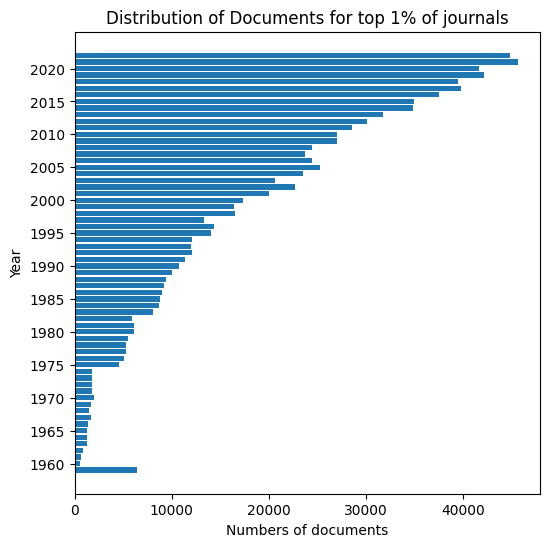

In [35]:
year_graph(docs_0, save_file='plots/year_graph.png', title= 'Distribution of Documents for top 1% of journals')

In [38]:
topic_model_0.topic_representations_

{-1: [('cells', 0.004660520758830483),
  ('patients', 0.0044657839163216),
  ('cell', 0.0042512503110266),
  ('protein', 0.003075013655669038),
  ('expression', 0.002844506548982436),
  ('disease', 0.0027738743446943767),
  ('human', 0.0026965870257949372),
  ('gene', 0.00267370598116356),
  ('associated', 0.0026735126833347628),
  ('study', 0.0026369833932374425)],
 0: [('patients', 0.021876131933283628),
  ('mg', 0.014557810146126041),
  ('dose', 0.013121160178416049),
  ('survival', 0.012752321543276827),
  ('chemotherapy', 0.011258255717539144),
  ('months', 0.011013059183757643),
  ('median', 0.010991558948353249),
  ('treatment', 0.00916163019171128),
  ('cancer', 0.00846401442293051),
  ('phase', 0.008288598366508382)],
 1: [('arabidopsis', 0.010433449477830375),
  ('membrane', 0.010105175000857685),
  ('protein', 0.010052167259436055),
  ('proteins', 0.009911504018468532),
  ('plant', 0.008097768926142992),
  ('plants', 0.007680208415514814),
  ('complex', 0.006210828711324795)

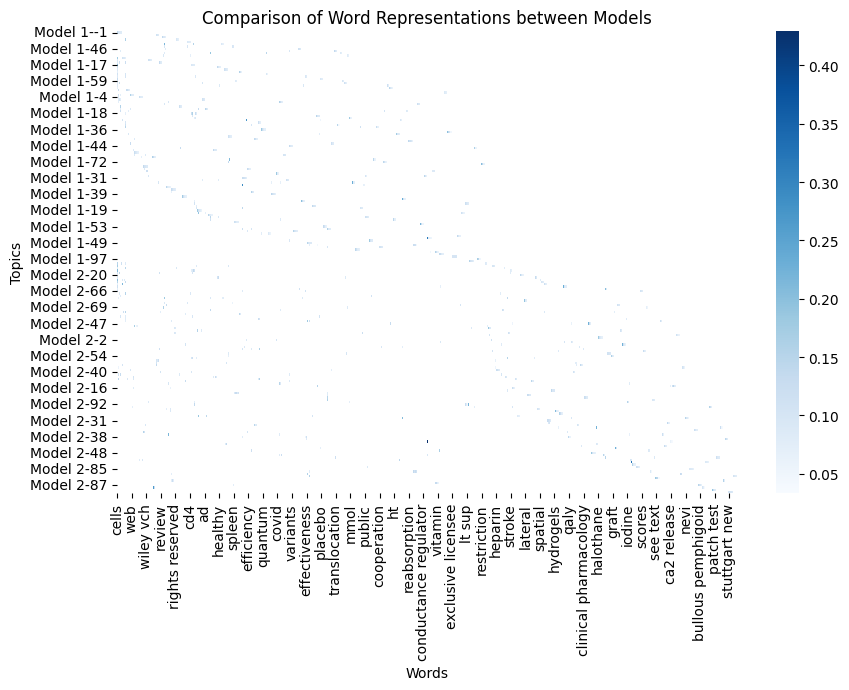

In [40]:
# Convert topic representations to pandas DataFrames
topic_representations_model1 = topic_model_0.topic_representations_
topic_representations_model2 = topic_model_12.topic_representations_

df_model1 = pd.DataFrame.from_dict({topic: dict(words) for topic, words in topic_representations_model1.items()}, orient='index')
df_model2 = pd.DataFrame.from_dict({topic: dict(words) for topic, words in topic_representations_model2.items()}, orient='index')

# Normalize the weights of each word within each topic
df_model1 = df_model1.div(df_model1.sum(axis=1), axis=0)
df_model2 = df_model2.div(df_model2.sum(axis=1), axis=0)

# Concatenate the DataFrames of different models
df_concat = pd.concat([df_model1, df_model2], keys=['Model 1', 'Model 2'])

# Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(df_concat, cmap='Blues')
plt.title('Comparison of Word Representations between Models')
plt.xlabel('Words')
plt.ylabel('Topics')
plt.show()

In [70]:
sortedsimilarity

array([[1.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.81818182, 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.05263158, 0.        , 0.05263158, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [55]:
def sort_singularity_mat(matrix):
    max_values = np.max(matrix, axis=1)
    sorted_indices = np.argsort(max_values)[::-1]
    sorted_similarity_matrix = matrix[sorted_indices]
    max_values_col = np.max(sorted_similarity_matrix, axis=0)
    sorted_indices_col = np.argsort(max_values_col)[::-1]
    sorted_similarity_matrix2 = sorted_similarity_matrix[:, sorted_indices_col]
    return sorted_similarity_matrix2, sorted_indices, sorted_indices_col
    
def genheatmaps(topic_representations_model1, topic_representations_model2, topic_labels1, topic_labels2, num_topics, mask_val=.2, xlabel="Topics 1", ylabel= "Topics 2", title= 'Comparison of Words in Each Topic between Model 1 and Model 2',savefig='plots/unnamed_heatmap'):  
    num_topics_model1 = len(topic_representations_model1)
    num_topics_model2 = len(topic_representations_model2)
    jaccard_matrix = np.zeros((num_topics_model1, num_topics_model2))

    # Calculate Jaccard similarity coefficients
    for i, (topic1, words1) in enumerate(topic_representations_model1.items()):
        for j, (topic2, words2) in enumerate(topic_representations_model2.items()):
            words_set1 = set(word for word, _ in words1)
            words_set2 = set(word for word, _ in words2)
            intersection = len(words_set1.intersection(words_set2))
            union = len(words_set1.union(words_set2))
            jaccard_matrix[i, j] = intersection / union
    sortedsimilarity, index_1, index_2 = sort_singularity_mat(jaccard_matrix)

    sorted_index = [topic_labels1[i] for i in index_1]
    sorted_index2 = [topic_labels2[i] for i in index_2]
    shortmat = sortedsimilarity[0:num_topics,0:num_topics]
    shortindex1 = sorted_index[0:num_topics]
    shortindex2 = sorted_index2[0:num_topics]   
    # Plot the heatmap
    plt.figure(figsize=(16, 12))
    plt.axes().set_facecolor("blue")
    #xticklabels=topic_representations_model2.keys(), yticklabels=topic_representations_model1.keys(),
    heatmap = sns.heatmap(shortmat.T, xticklabels=shortindex2, yticklabels=shortindex1, cmap='spring',  mask=shortmat <= mask_val)
    plt.title(title)
    plt.xticks(rotation=30, ha='right', rotation_mode='anchor')
    #plt.tick_params(labelsize=7)
    plt.xlabel(xlabel, weight = 'bold',style='italic', fontsize = 16)
    plt.ylabel(ylabel, weight = 'bold', style='italic',fontsize = 16)
    plt.savefig(savefig, bbox_inches='tight')
    plt.show()

  


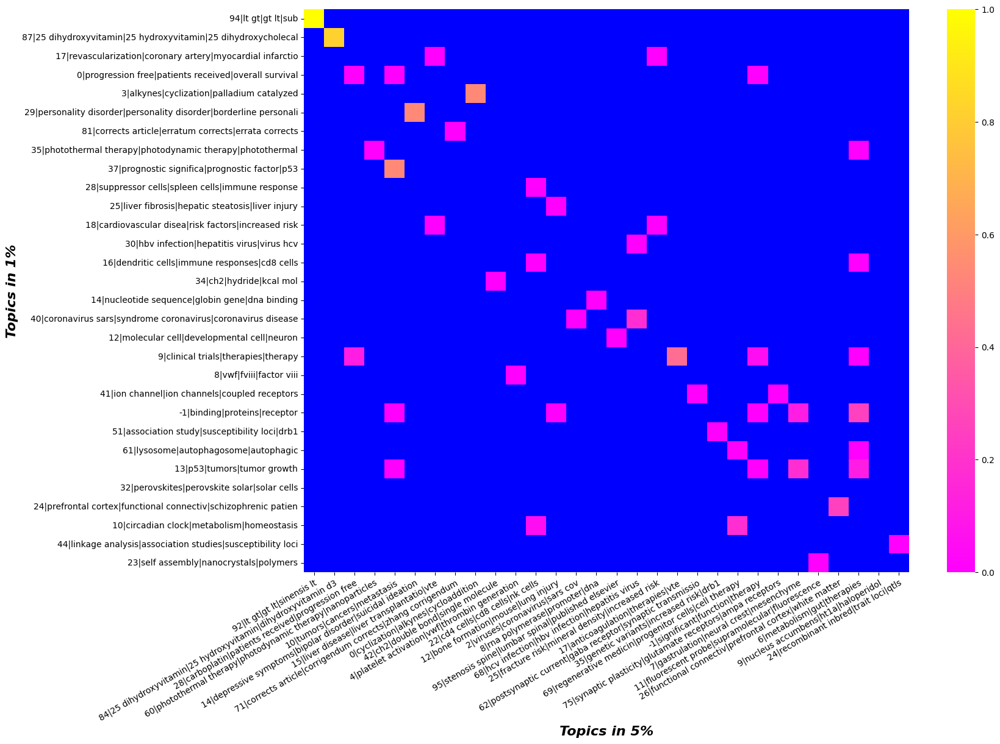

In [57]:
genheatmaps(topic_model_0.topic_representations_, topic_model_12.topic_representations_, topic_labels2, topic_labels_12, 30, mask_val=.15, xlabel="Topics in 5%", ylabel= "Topics in 1%", title= None,savefig='plots/heatmap1to5.pdf')

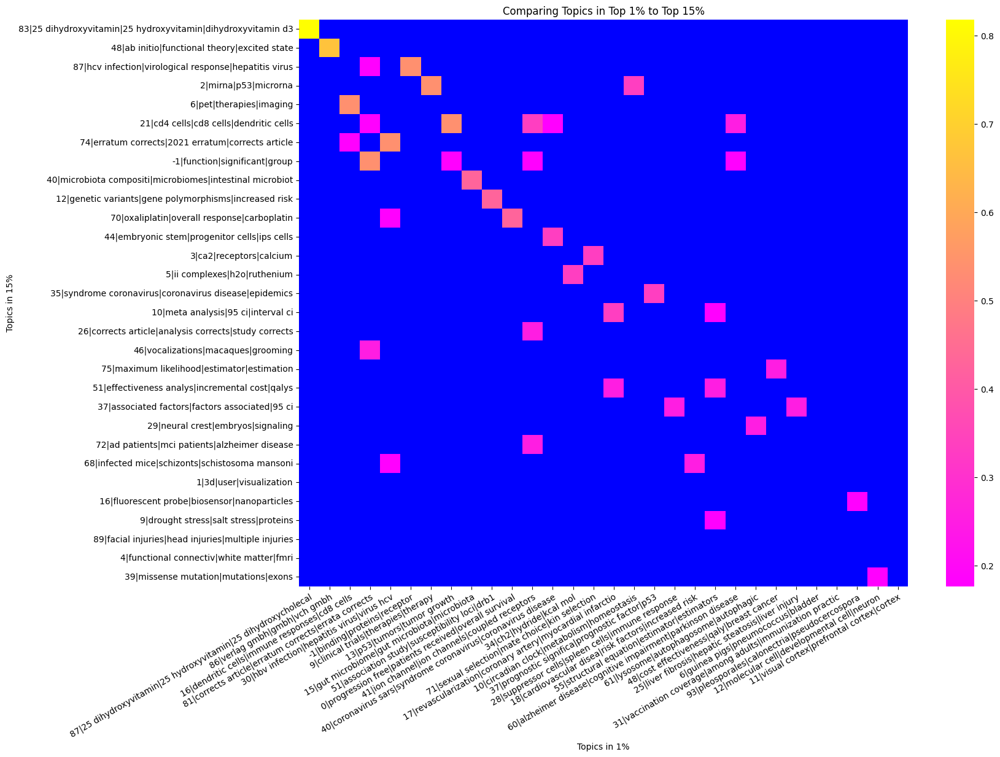

In [51]:
genheatmaps(topic_model_0.topic_representations_, topic_model_36.topic_representations_, topic_labels2, topic_labels_36, 30, mask_val=.15,title= 'Comparing Topics in Top 1% to Top 15%', xlabel="Topics in 1%", ylabel= "Topics in 15%", savefig='plots/heatmap1to15.pdf')

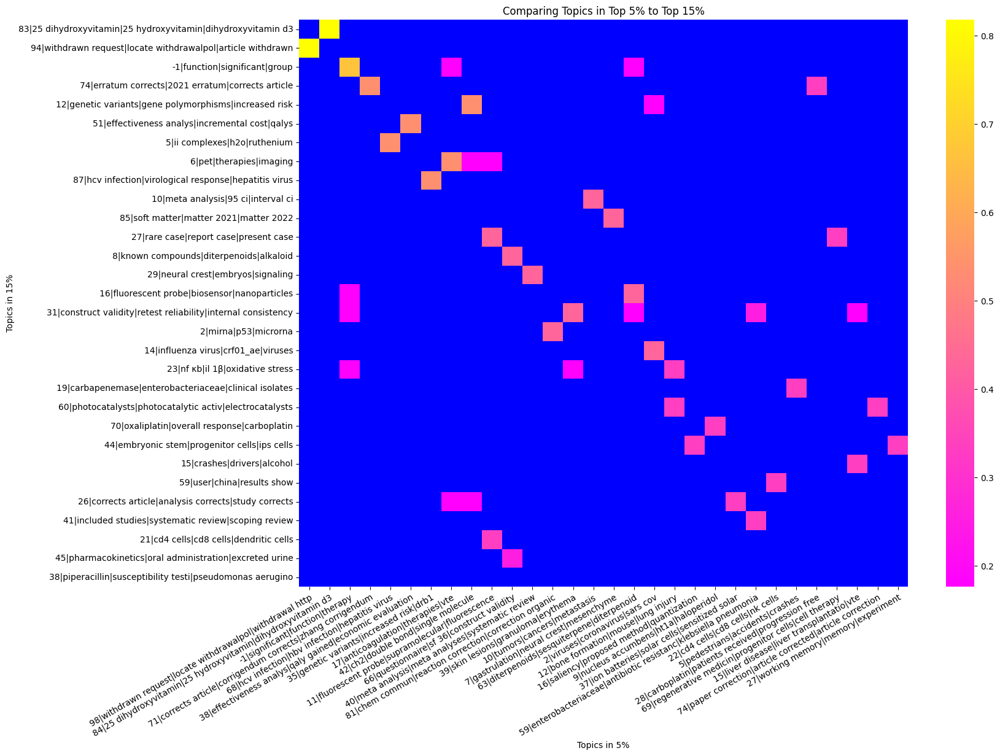

In [52]:
genheatmaps(topic_model_12.topic_representations_, topic_model_36.topic_representations_, topic_labels_12, topic_labels_36, 30, mask_val=.15, title= 'Comparing Topics in Top 5% to Top 15%',xlabel="Topics in 5%", ylabel= "Topics in 15%", savefig='plots/heatmap5to15.pdf')

In [47]:
docs_0[docs_0['Topic']==7].head(50)

,Document,Topic,Year,Journal,Date,bin_period
22,protein purification : adsorption chromatograp...,7,1976,"Science (New York, N.Y.)",1976-01-30,0
71,effect excision y-base interaction trnaphe ( y...,7,1976,Nucleic acids research,1976-03-01,0
72,distribution histones alkali-denatured chromat...,7,1976,Nucleic acids research,1976-03-01,0
75,"o2'-methylinosine , constituent ribosomal rna ...",7,1976,Nucleic acids research,1976-04-01,0
103,mechanism action ppgpp rrna synthesis vitro .....,7,1976,Cell,1976-05-01,0
106,naturally occurring cross-links yeast chromoso...,7,1976,Cell,1976-07-01,0
116,affinity labelling phenylalanyl-trna synthetas...,7,1976,Nucleic acids research,1976-06-01,0
130,properties dna ligase uninfected virus-infecte...,7,1976,Nucleic acids research,1976-08-01,0
131,histones bind tightly bromodeoxyuridine-substi...,7,1976,Nucleic acids research,1976-09-01,0
133,novikoff hepatoma deoxyribonucleic acid polyme...,7,1976,Nucleic acids research,1976-09-01,0


In [34]:
matrix_0_freq = topics_over_time_freq(docs_0,topic_labels2)

In [29]:
topic_0 = matrix_0_freq[matrix_0_freq['Topic'] == 87]
topic_12 = matrix_12_freq[matrix_12_freq['Topic'] == 84]
topic_36 = matrix_36_freq[matrix_36_freq['Topic'] == 83] #.drop(columns = ['index', 'largest'])


NameError: name 'matrix_0_freq' is not defined

In [12]:
doc_0

NameError: name 'doc_0' is not defined

In [120]:
len(topic_12.values[0])

21

In [121]:
topic_mat

bin_period,index,Topic,0,1,2,3,4,5,6,7,...,10,11,12,13,14,15,16,17,18,19
0,26,87,0.363636,0.787879,1.0,0.545455,0.515152,0.363636,0.363636,0.363636,...,0.090909,0.090909,0.0,0.060606,0.090909,0.060606,0.060606,0.030303,0.030303,0.030303


'0|progression free|patients received|overall survival'

In [73]:
topic_mat = topic_0.reset_index().drop(columns='index')
topic_mat.loc[1] = topic_12.values[0]
topic_mat.loc[2] = topic_36.values[0]

In [80]:
topic_mat

bin_period,Topic,0,1,2,3,4,5,6,7,8,...,10,11,12,13,14,15,16,17,18,19
0,87.0,0.069767,0.151163,0.191860,0.104651,0.098837,0.069767,0.069767,0.069767,0.040698,...,0.017442,0.017442,0.000000,0.011628,0.017442,0.011628,0.011628,0.005814,0.005814,0.005814
1,84.0,0.189349,0.325444,0.171598,0.100592,0.076923,0.029586,0.023669,0.017751,0.017751,...,0.011834,0.000000,0.000000,0.005917,0.000000,0.000000,0.005917,0.000000,0.005917,0.000000
2,83.0,0.176849,0.231511,0.122186,0.151125,0.086817,0.041801,0.025723,0.032154,0.028939,...,0.009646,0.028939,0.003215,0.016077,0.003215,0.012862,0.003215,0.003215,0.003215,0.003215


In [28]:
x = np.array(range(0,20))
plt.plot(x, topic_mat.drop(columns=['Topic']).T, '-', label=['1%','5%','15%'])
plt.xlabel("Bin Period")
plt.ylabel("Relative Topic Frequency")
plt.legend()
plt.savefig('plots/TopicComparison1.pdf', bbox_inches='tight')

NameError: name 'topic_mat' is not defined

In [55]:
full_dat = pd.read_csv('/mnt/home/ande2472/data/full_clean_data/sorted_full_data.csv', sep='\t')

In [21]:
topic_embeddings = topic_model_0.topic_embeddings_

In [19]:
def gpu_cosine_similarity(matrix):
    norm = Normalizer()
    norm_matrix = norm.transform(matrix)
    K = safe_sparse_dot(norm_matrix, norm_matrix.T, dense_output=True) 
    return K

In [22]:
sim_matrix = gpu_cosine_similarity(topic_embeddings)

In [23]:
import plotly.figure_factory as ff
fig = ff.create_distplot(sim_matrix, topic_labels2,bin_size=.025)
fig.show()

In [54]:
sim_matrix[:20]

array([[1.        , 0.94191782, 0.93774688, ..., 0.93157633, 0.86237436,
        0.89625643],
       [0.94191782, 1.        , 0.90848324, ..., 0.92029318, 0.85628043,
        0.88034348],
       [0.93774688, 0.90848324, 1.        , ..., 0.92035903, 0.88978046,
        0.88162478],
       ...,
       [0.96229151, 0.92023077, 0.94590409, ..., 0.90972949, 0.88121601,
        0.87245425],
       [0.93782351, 0.94505239, 0.88667461, ..., 0.91096758, 0.85742617,
        0.89038038],
       [0.9167618 , 0.93003445, 0.90219358, ..., 0.91680594, 0.86212158,
        0.87928856]])

In [55]:
topic_labels2[:20]

['-1|binding|proteins|receptor',
 '0|progression free|patients received|overall survival',
 '1|endoplasmic reticulu|arabidopsis thaliana|kinesin',
 '2|3d|annotation|user',
 '3|alkynes|cyclization|palladium catalyzed',
 '4|quadruplexes|oligonucleotides|quadruplex',
 '5|ion batteries|electrocatalysts|anodes',
 '6|guinea pigs|pneumococcus|bladder',
 '7|crispr cas|crispr cas9|genome editing',
 '8|vwf|fviii|factor viii',
 '9|clinical trials|therapies|therapy',
 '10|circadian clock|metabolism|homeostasis',
 '11|visual cortex|prefrontal cortex|cortex',
 '12|molecular cell|developmental cell|neuron',
 '13|p53|tumors|tumor growth',
 '14|nucleotide sequence|globin gene|dna binding',
 '15|gut microbiome|gut microbiota|microbiota',
 '16|dendritic cells|immune responses|cd8 cells',
 '17|revascularization|coronary artery|myocardial infarctio',
 '18|cardiovascular disea|risk factors|increased risk']

In [58]:
fig = ff.create_distplot(sim_matrix[:19], topic_labels2[:19],bin_size=.025)
fig.show()

In [59]:
fig = ff.create_distplot(sim_matrix[20:39], topic_labels2[20:39],bin_size=.025)
fig.show()

In [60]:
fig = ff.create_distplot(sim_matrix[40:59], topic_labels2[40:59],bin_size=.025)
fig.show()

In [63]:
fig = ff.create_distplot(sim_matrix[60:79], topic_labels2[60:79],bin_size=.025)
fig.show()

In [64]:
fig = ff.create_distplot(sim_matrix[80:99], topic_labels2[80:99],bin_size=.025)
fig.show()

In [68]:
topic_model_0.probabilities_.shape

(974824, 99)

- List indexes of all documents whos topic has been assigned to 1:

In [14]:
topic_list = list(docs_0[docs_0['Topic'] == 1].index)

- Then get the original probability of each one of these topics being assigned to 1:

In [15]:
within_dist = topic_model_0.probabilities_[topic_list,1]

- Now create distplot for within distribution:

In [25]:
fig = ff.create_distplot([within_dist], ['Within Group'],bin_size=.025)
fig.show()

- loading in embeddings

In [28]:
file = '/mnt/scratch/ande2472/data/0_topjournals/0to264_topjournals_embs.pickle'
with open(file, "rb") as f:
    emb = pickle.load(f)

- generating cosine similarity matrix for all topics within topic 1 (index from topic_list generated earlier)

In [32]:
within_sim_mat = gpu_cosine_similarity(emb[topic_list])

: 

: 

- crashed the kernel, moving code to topicsimilarity.py

In [10]:
save_dir = dir_0full/'sim_matrix_test.pickle'
with open(save_dir, "rb") as f:
    sim_mat = pickle.load(f)

In [14]:
sim_mat.shape

(55033, 55033)

In [19]:
iu1 = np.triu_indices(len(sim_mat), k=1)

MemoryError: Unable to allocate 11.3 GiB for an array with shape (1514288028,) and data type int64

: 

In [18]:
iu1

(array([    0,     0,     0, ..., 55031, 55031, 55032]),
 array([    0,     1,     2, ..., 55031, 55032, 55032]))